# Coursework 2: Generative Models

## Instructions

### Submission 
Please submit one zip file on cate - *CW2.zip* containing the following:
1. A version of this notebook containing your answers. Write your answers in the cells below each question. **Please deliver the notebook including the outputs of the cells**
2. Your trained VAE model as *VAE_model.pth*
3. Your trained Generator and Discriminator: *DCGAN_model_D.pth and DCGAN_model_G.pth*


### Training
Training the GAN will take quite a long time (multiple hours), please refer to the 4 GPU options detailed in the logistics lecture. Some additional useful pointers:
* PaperSpace [guide if you need more compute](https://hackmd.io/@afspies/S1stL8Qnt)
* Lab GPUs via SSH.  The VSCode Remote Develop extension is recommended for this. For general Imperial remote working instructions see [this post](https://www.doc.ic.ac.uk/~nuric/teaching/remote-working-for-imperial-computing-students.html). You'll also want to [setup your environment as outlined here](https://hackmd.io/@afspies/Bkd7Zq60K).
* Use Colab and add checkpointing to the model training code; this is to handle the case where colab stops a free-GPU kernel after a certain number of hours (~4).
* Use Colab Pro - If you do not wish to use PaperSpace then you can pay for Colab Pro. We cannot pay for this on your behalf (this is Google's fault).


### Testing
TAs will run a testing cell (at the end of this notebook), so you are required to copy your data ```transform``` and ```denorm``` functions to a cell near the bottom of the document (it is demarkated). You are advised to check that your implementations pass these tests (in particular, the jit saving and loading may not work for certain niche functions)

### General
You can feel free to add architectural alterations / custom functions outside of pre-defined code blocks, but if you manipulate the model's inputs in some way, please include the same code in the TA test cell, so our tests will run easily.

<font color="orange">**The deadline for submission is Monday, 26 Feb by 6 pm** </font>

## Setting up working environment
You will need to install pytorch and import some utilities by running the following cell:

In [1]:
#!pip install -q torch torchvision altair seaborn
!pip install -q torch torchvision altair==4.2.2 seaborn tqdm
!git clone -q https://github.com/afspies/icl_dl_cw2_utils
from icl_dl_cw2_utils.utils.plotting import plot_tsne
from pathlib import Path
import tqdm

fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.


Here we have some default pathing options which vary depending on the environment you are using. You can of course change these as you please.

In [2]:
# Initialization Cell
#WORKING_ENV = 'COLAB' # Can be LABS, COLAB, PAPERSPACE, SAGEMAKER
WORKING_ENV = 'PAPERSPACE' # Can be LABS, COLAB, PAPERSPACE, SAGEMAKER

USERNAME = '' # If working on Lab Machines - Your college username
assert WORKING_ENV in ['LABS', 'COLAB', 'PAPERSPACE', 'SAGEMAKER']

if WORKING_ENV == 'COLAB':
    from google.colab import drive
    %load_ext google.colab.data_table
    dl_cw2_repo_path = 'dl_cw2/' # path in your gdrive to the repo
    content_path = f'/content/drive/MyDrive/{dl_cw2_repo_path}' # path to gitrepo in gdrive after mounting
    data_path = './data/' # save the data locally
    drive.mount('/content/drive/') # Outputs will be saved in your google drive

elif WORKING_ENV == 'LABS':
    content_path = f'/vol/bitbucket/{USERNAME}/dl/dl_cw2/' # You may want to change this
    data_path = f'/vol/bitbucket/{USERNAME}/dl/'
    # Your python env and training data should be on bitbucket
    if 'vol/bitbucket' not in content_path or 'vol/bitbucket' not in data_path:
        import warnings
        warnings.warn(
           'It is best to create a dir in /vol/bitbucket/ otherwise you will quickly run into memory issues'
           )
elif WORKING_ENV == 'PAPERSPACE': # Using Paperspace
    # Paperspace does not properly render animated progress bars
    # Strongly recommend using the JupyterLab UI instead of theirs
    !pip install ipywidgets
    content_path = '/notebooks/'
    data_path = './data/'
    
elif WORKING_ENV == 'SAGEMAKER':
    content_path = '/home/studio-lab-user/sagemaker-studiolab-notebooks/dl/'
    data_path = f'{content_path}data/'

else:
  raise NotImplementedError()

content_path = Path(content_path)

## Introduction

For this coursework, you are asked to implement two commonly used generative models:
1. A **Variational Autoencoder (VAE)**
2. A **Deep Convolutional Generative Adversarial Network (DCGAN)**

For the first part you will the MNIST dataset https://en.wikipedia.org/wiki/MNIST_database and for the second the CIFAR-10 (https://www.cs.toronto.edu/~kriz/cifar.html).

Each part is worth 50 points. 

The emphasis of both parts lies in understanding how the models behave and learn, however, some points will be available for getting good results with your GAN (though you should not spend too long on this).

# Part 1 - Variational Autoencoder

## Part 1.1 (25 points)
**Your Task:**

a. Implement the VAE architecture with accompanying hyperparameters. More marks are awarded for using a Convolutional Encoder and Decoder.

b. Design an appropriate loss function and train the model.


In [55]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_VAE/'):
    os.makedirs(content_path/'CW_VAE/')

if not os.path.exists(data_path):
    os.makedirs(data_path)

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

Using cuda


---
## Part 1.1a: Implement VAE (25 Points)
### Hyper-parameter selection


In [56]:
# Necessary Hyperparameters 
num_epochs = 20
learning_rate = 0.001
batch_size = 64
latent_dim = 50 # Choose a value for the size of the latent space

# Additional Hyperparameters 

beta = 0.9
# (Optionally) Modify transformations on input
transform = transforms.Compose([
    transforms.ToTensor(),
])

# (Optionally) Modify the network's output for visualizing your images
def denorm(x):
    return x

### Data loading


In [57]:
train_dat = datasets.MNIST(
    data_path, train=True, download=True, transform=transform
)
test_dat = datasets.MNIST(data_path, train=False, transform=transform)

loader_train = DataLoader(train_dat, batch_size, shuffle=True)
loader_test = DataLoader(test_dat, batch_size, shuffle=False)

# Don't change 
sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[:32, :, :, :]
save_image(fixed_input, content_path/'CW_VAE/image_original.png')

### Model Definition

<figure>
  <img src="https://blog.bayeslabs.co/assets/img/vae-gaussian.png" style="width:60%">
  <figcaption>
    Fig.1 - VAE Diagram (with a Guassian prior), taken from <a href="https://blog.bayeslabs.co/2019/06/04/All-you-need-to-know-about-Vae.html">1</a>.
  </figcaption>
</figure>


You will need to define:
* The hyperparameters
* The constructor
* encode
* reparametrize
* decode
* forward



Hints:
- It is common practice to encode the log of the variance, rather than the variance
- You might try using BatchNorm

In [58]:
# *CODE FOR PART 1.1a IN THIS CELL*
# intial is 28x28

class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################        
        modules = []
        
        hidden_dimensions = [32, 64, 128, 256]
        
        # after printing the data i found shape : torch.Size([32, 1, 28, 28])
        in_channels=1
        # print("in channels:",in_channels)
        

        # Build Encoder
        for dim in hidden_dimensions:
            modules.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, out_channels=dim,
                              kernel_size= 3, stride= 2, padding  = 1),
                    nn.BatchNorm2d(dim),
                    nn.LeakyReLU())
            )
            in_channels = dim

        self.encoder = nn.Sequential(*modules)

        #self.linear_layer_1 = nn.Linear(hidden_dimensions[-1] * 3*3, 1024)

        self.linear_layer_1 = nn.Linear(int(hidden_dimensions[-1] * 2*2), 1024)
        self.linear_layer_2 = nn.Linear(1024, 512)

        # self.fc_mu = nn.Linear(hidden_dimensions[-1] * 3*3, latent_dim)
        # self.fc_var = nn.Linear(hidden_dimensions[-1]* 3*3, latent_dim)
        
        self.fc_mu = nn.Linear(512, latent_dim)
        self.fc_var = nn.Linear(512, latent_dim)


      
        ########################        Build Decoder           #################
        
        modules = []
        
        self.linear_layer_3 = nn.Linear(latent_dim, 512)
        self.linear_layer_4 = nn.Linear(512, 1024)
        
        
        self.decoder_input = nn.Linear(1024, int(hidden_dimensions[-1] * 2*2))

        # lets reverse the list to do a straight forward for loop
        hidden_dimensions.reverse()

        for i in range(len(hidden_dimensions) - 1):
            modules.append(
                nn.Sequential(
                    nn.ConvTranspose2d(hidden_dimensions[i],
                                       hidden_dimensions[i + 1],
                                       kernel_size=3,
                                       stride = 2,
                                       padding=1,
                                       output_padding=1),
                    nn.BatchNorm2d(hidden_dimensions[i + 1]),
                    nn.LeakyReLU())
            )



        self.decoder = nn.Sequential(*modules)

        # HERE make change
        self.final_layer = nn.ConvTranspose2d(hidden_dimensions[-1],
                                               1,
                                               kernel_size=2,
                                               stride=2,
                                               padding=2,
                                               output_padding=0)
                        
        
                            
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
    def encode(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        x=x.to(device)
        # print("Initial in encoder ", x.shape)
        
        encoded_result = self.encoder(x)
        
        # print("Encoded result ",encoded_result.shape)

        result = torch.flatten(encoded_result, start_dim=1)
        
        # print("flatten result ",result.shape)
    
        
        result=F.relu(self.linear_layer_1(result))
        
        # print("linear 1 result ",result.shape)

        result=F.relu(self.linear_layer_2(result))
        
        # print("linear 2 result ",result.shape)

        # Split the result into mu and var components
        # of the latent Gaussian distribution
        mu = self.fc_mu(result)
        log_var = self.fc_var(result)

        return [mu, log_var]
    
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
    
    def reparametrize(self, mu, logvar):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        return torch.exp( logvar / 2) * torch.randn_like(torch.exp(logvar / 2)) + mu

        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

    def decode(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # print("initial in decoder is::::", z.shape)

        z=F.relu(self.linear_layer_3(z))
        # print("After 1 layer res ", z.shape)

        z=F.relu(self.linear_layer_4(z))
        # print("After 2 layer res ", z.shape)

        
        decoded_result = F.relu(self.decoder_input(z))
        
        # print("Decoded res ", decoded_result.shape)
        
        decoded_result = decoded_result.view(-1, 256, 2, 2)
        
        # print("after Reformatting result",decoded_result.shape)
        
        decoded_result = self.decoder(decoded_result)
        # print("After all dec COnvolutions(is one less than real) ",decoded_result.shape)

        
        final_result = self.final_layer(decoded_result)
        # print("After final convolution(this should take me to 1) ",final_result.shape)
        
        return torch.sigmoid(final_result)

        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
    
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        mu, log_var=self.encode(x)
        mid_result=self.reparametrize(mu,log_var)
        
        rec_x=self.decode(mid_result)
        
        return rec_x, mu,log_var

        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 


print(fixed_input.shape)        
model = VAE(latent_dim).to(device)
params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))
print(model)
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)


torch.Size([32, 1, 28, 28])
Total number of parameters is: 4003397
VAE(
  (encoder): Sequential(
    (0): Sequential(
      (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (1): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)

--- 

## Part 1.1b: Training the Model (5 Points)

### Defining a Loss
Recall the Beta VAE loss, with an encoder $q$ and decoder $p$:
$$ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$$

In order to implement this loss you will need to think carefully about your model's outputs and the choice of prior.

There are multiple accepted solutions. Explain your design choices based on the assumptions you make regarding the distribution of your data.

* Hint: this refers to the log likelihood as mentioned in the tutorial. Make sure these assumptions reflect on the values of your input data, i.e. depending on your choice you might need to do a simple preprocessing step.

* You are encouraged to experiment with the weighting coefficient $\beta$ and observe how it affects your training

In [59]:
# *CODE FOR PART 1.1b IN THIS CELL*

def loss_function_VAE(recon_x, x, mu, logvar, beta):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # as we know we have 3 losses, the reconstruction, the KL divergence loss, and the total
        #print("recon:",recon_x.shape, " real ",x.shape)
        # why  use mse , lets use cross entropy
        
        reconstruction = F.mse_loss(recon_x, x, size_average=False, reduction='sum')
        kld = torch.sum(torch.exp(logvar) + mu**2 - logvar - 1.0) / 2
        total_loss = reconstruction + beta*kld

        # return as kld,reconstruction,total loss
        return kld,reconstruction,total_loss
             
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

        
# i create the main train funciton which is actually one train step, gets all the data iterates through all batches and
# returns all losses
    
    
def train_step(current_epoch_number,model,loader_train_,beta=1):
    reconstruction_loss=0;kld_loss=0;total_loss=0
    
    with tqdm.tqdm(loader_train_, unit="batch") as tepoch: 
        for batch_idx, (data, _) in enumerate(tepoch):   
            X=data.to(device)
            
            data = data 
            
            reconstruction_x, mu, logvar=model(X)
            
            kld_gr,reconstruction_gr,loss=loss_function_VAE(reconstruction_x, X, mu, logvar, beta)
            batch_size=data.shape[0]
            # these are the losses for the whole batch so lets find the mean!

            loss = loss / batch_size
            reconstruction_loss+=reconstruction_gr.item()/batch_size
            total_loss+=loss.item()
            kld_loss+=kld_gr.item()/batch_size
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            if batch_idx % 20 ==0:
                tepoch.set_description(f"Epoch {current_epoch_number}")
                tepoch.set_postfix(loss=loss.item()/len(data))

    # losses for all batches so find mean of losses of all different batches   
    number_of_batches=len(loader_train_.dataset)
    
    total_loss=total_loss/number_of_batches
    
    kld_loss=kld_loss/number_of_batches
    
    reconstruction_loss=reconstruction_loss/number_of_batches
    
    #return total-loss,kld,reconstruction
    return total_loss,kld_loss,reconstruction_loss,data


def test_step(current_epoch_number,model, loader_test_,beta=1):
    model.eval()
    
    reconstruction_loss=0;kld_loss=0;total_loss=0
    
    for idx, (data_test, _) in enumerate(loader_test_):   
        X=data_test.to(device)

        reconstruction_x, mu, logvar=model(X)
        
        kld_gr,reconstruction_gr,loss=loss_function_VAE(reconstruction_x, X, mu, logvar, beta)
        
        data_size=data_test.shape[0]
        # these are the losses for the whole batch so lets find the mean!

        loss = loss / data_size
        
        reconstruction_loss+=reconstruction_gr.item()/data_size
        total_loss+=loss.item()
        kld_loss+=kld_gr.item()/data_size

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    number_of_batches=len(loader_test_.dataset)
    
    total_loss=total_loss/number_of_batches
    
    kld_loss=kld_loss/number_of_batches
    
    reconstruction_loss=reconstruction_loss/number_of_batches
    #return total-loss,kld,reconstruction
    return total_loss,kld_loss,reconstruction_loss


            
#model.train()
    
# <- You may wish to add logging info here
total_loss_train=[];kld_loss_train=[];reconstruction_loss_train=[]
total_loss_test=[];kld_loss_test=[];reconstruction_loss_test=[]


for epoch in range(num_epochs):  
    # <- You may wish to add logging info here
    # with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
    #     for batch_idx, (data, _) in enumerate(tepoch):   
            #######################################################################
            #                       ** START OF YOUR CODE **
            #######################################################################
    #data = data #Need at least one batch/random data with right shape -
                # This is required to initialize to model properly below
                # when we save the computational graph for testing (jit.save)
    #loss = None
    loss,kld,reconstruction, data=train_step(epoch,model,loader_train,beta)
    
    total_loss_train.append(loss);kld_loss_train.append(kld);reconstruction_loss_train.append(reconstruction)
    print("Training: Epoch:",epoch,"total:",loss," kld:",kld," reconstruction:",reconstruction)
    
    loss,kld,reconstruction=test_step(epoch,model,loader_test,beta)
    
    total_loss_test.append(loss);kld_loss_test.append(kld);reconstruction_loss_test.append(reconstruction)
    print("Test: Epoch:",epoch,"total:",loss," kld:",kld," reconstruction:",reconstruction)

            
            #######################################################################
            #                       ** END OF YOUR CODE **
            ####################################################################### 
            # if batch_idx % 20 == 0:
            #     tepoch.set_description(f"Epoch {epoch}")
            #     tepoch.set_postfix(loss=loss.item()/len(data))
        

    # save the model
    if (epoch == num_epochs - 1):
        with torch.no_grad():
            torch.jit.save(torch.jit.trace(model, (data), check_trace=False),
                content_path/'CW_VAE/VAE_model.pth')


  0%|          | 0/938 [00:00<?, ?batch/s]/usr/local/lib/python3.9/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))
Epoch 0: 100%|██████████| 938/938 [00:13<00:00, 72.13batch/s, loss=0.714]


Training: Epoch: 0 total: 0.7709595217386882  kld: 0.02568543685482194  reconstruction: 0.747842628479004
Test: Epoch: 0 total: 0.7142876110076904  kld: 0.037539635002613064  reconstruction: 0.6805019393920898


Epoch 1: 100%|██████████| 938/938 [00:12<00:00, 73.56batch/s, loss=0.695]


Training: Epoch: 1 total: 0.6859342010498047  kld: 0.04283848325014114  reconstruction: 0.6473795669555664
Test: Epoch: 1 total: 0.6706110805511475  kld: 0.045353854393959045  reconstruction: 0.6297926128387451


Epoch 2: 100%|██████████| 938/938 [00:13<00:00, 70.65batch/s, loss=0.667]


Training: Epoch: 2 total: 0.6572747926076253  kld: 0.04813999445041021  reconstruction: 0.6139487988154093
Test: Epoch: 2 total: 0.6654813762664795  kld: 0.04843782901763916  reconstruction: 0.6218873329162597


Epoch 3: 100%|██████████| 938/938 [00:12<00:00, 73.23batch/s, loss=0.599]


Training: Epoch: 3 total: 0.6439339104334514  kld: 0.05141897434790929  reconstruction: 0.5976568348566691
Test: Epoch: 3 total: 0.6423879596710205  kld: 0.050994762873649596  reconstruction: 0.5964926738739014


Epoch 4: 100%|██████████| 938/938 [00:12<00:00, 72.39batch/s, loss=0.634]


Training: Epoch: 4 total: 0.6410478944142659  kld: 0.05237842109998067  reconstruction: 0.5939073163668315
Test: Epoch: 4 total: 0.6365077552795411  kld: 0.052778933644294736  reconstruction: 0.5890067176818847


Epoch 5: 100%|██████████| 938/938 [00:13<00:00, 71.47batch/s, loss=0.582]


Training: Epoch: 5 total: 0.6316282777150471  kld: 0.0538046485821406  reconstruction: 0.5832040966351827
Test: Epoch: 5 total: 0.6379862739562988  kld: 0.05389988460540771  reconstruction: 0.5894763788223266


Epoch 6: 100%|██████████| 938/938 [00:13<00:00, 71.12batch/s, loss=0.684]


Training: Epoch: 6 total: 0.6413969213485717  kld: 0.05742203358809153  reconstruction: 0.5897170921325684
Test: Epoch: 6 total: 0.6591436367034912  kld: 0.06389351336956024  reconstruction: 0.6016394783020019


Epoch 7: 100%|██████████| 938/938 [00:13<00:00, 71.46batch/s, loss=0.63] 


Training: Epoch: 7 total: 0.6179832565307617  kld: 0.07010622724692027  reconstruction: 0.5548876532554626
Test: Epoch: 7 total: 0.6096743270874023  kld: 0.07102344794273377  reconstruction: 0.5457532264709473


Epoch 8: 100%|██████████| 938/938 [00:13<00:00, 71.04batch/s, loss=0.545]


Training: Epoch: 8 total: 0.6094295714060466  kld: 0.07024620885054271  reconstruction: 0.5462079842249552
Test: Epoch: 8 total: 0.6007501388549805  kld: 0.07158522732257842  reconstruction: 0.5363234378814697


Epoch 9: 100%|██████████| 938/938 [00:13<00:00, 70.05batch/s, loss=0.568]


Training: Epoch: 9 total: 0.5912422443072001  kld: 0.07323482933441798  reconstruction: 0.5253308990160624
Test: Epoch: 9 total: 0.5921100370407104  kld: 0.0748551760673523  reconstruction: 0.5247403772354126


Epoch 10: 100%|██████████| 938/938 [00:13<00:00, 72.02batch/s, loss=0.619]


Training: Epoch: 10 total: 0.5771964022636413  kld: 0.07625068545341492  reconstruction: 0.5085707865715027
Test: Epoch: 10 total: 0.5767316955566406  kld: 0.07808378419876098  reconstruction: 0.5064562923431396


Epoch 11: 100%|██████████| 938/938 [00:13<00:00, 69.98batch/s, loss=0.607]


Training: Epoch: 11 total: 0.5795224159240723  kld: 0.0812868399699529  reconstruction: 0.5063642615318298
Test: Epoch: 11 total: 0.575163041305542  kld: 0.0829806402683258  reconstruction: 0.5004804647445679


Epoch 12: 100%|██████████| 938/938 [00:13<00:00, 71.61batch/s, loss=0.571]


Training: Epoch: 12 total: 0.5658146382331848  kld: 0.08310659721692402  reconstruction: 0.4910187033017476
Test: Epoch: 12 total: 0.5639665054321289  kld: 0.08191204757690429  reconstruction: 0.4902456636428833


Epoch 13: 100%|██████████| 938/938 [00:13<00:00, 71.08batch/s, loss=0.539]


Training: Epoch: 13 total: 0.5561737234751384  kld: 0.08322642871538798  reconstruction: 0.48126993951797487
Test: Epoch: 13 total: 0.5592485240936279  kld: 0.08219560270309448  reconstruction: 0.48527248096466064


Epoch 14: 100%|██████████| 938/938 [00:13<00:00, 70.03batch/s, loss=0.541]


Training: Epoch: 14 total: 0.5495393267631531  kld: 0.08353286273479461  reconstruction: 0.4743597515424093
Test: Epoch: 14 total: 0.5522014064788818  kld: 0.08297156867980957  reconstruction: 0.477526997756958


Epoch 15: 100%|██████████| 938/938 [00:12<00:00, 73.35batch/s, loss=0.498]


Training: Epoch: 15 total: 0.5457050552050272  kld: 0.08351862870057424  reconstruction: 0.470538291200002
Test: Epoch: 15 total: 0.5476196977615356  kld: 0.08330896492004394  reconstruction: 0.47264163246154783


Epoch 16: 100%|██████████| 938/938 [00:12<00:00, 72.82batch/s, loss=0.485]


Training: Epoch: 16 total: 0.543099429734548  kld: 0.08421615971724192  reconstruction: 0.467304887453715
Test: Epoch: 16 total: 0.545655979347229  kld: 0.0837873966217041  reconstruction: 0.4702473239898682


Epoch 17: 100%|██████████| 938/938 [00:12<00:00, 72.47batch/s, loss=0.497]


Training: Epoch: 17 total: 0.5399040924708048  kld: 0.08463653305371602  reconstruction: 0.46373121490478514
Test: Epoch: 17 total: 0.5431509742736816  kld: 0.0840309105873108  reconstruction: 0.46752315788269044


Epoch 18: 100%|██████████| 938/938 [00:12<00:00, 73.05batch/s, loss=0.56] 


Training: Epoch: 18 total: 0.5384413347562154  kld: 0.08509720310370128  reconstruction: 0.46185385440190635
Test: Epoch: 18 total: 0.5404878717422485  kld: 0.0846970941066742  reconstruction: 0.4642604887008667


Epoch 19: 100%|██████████| 938/938 [00:13<00:00, 71.61batch/s, loss=0.473]


Training: Epoch: 19 total: 0.5343535791397095  kld: 0.08544433149496715  reconstruction: 0.45745368270874026
Test: Epoch: 19 total: 0.5366253932952881  kld: 0.08569304957389831  reconstruction: 0.4595016481399536


### Loss Explanation
Explain your choice of loss and how this relates to:

* The VAE Prior
* The output data domain
* Disentanglement in the latent space

Answer:

In a variational Autoencoder (VAE) it is important to choose good a loss function as
it defines the model's ability to generrate and learn the data.
The loss in our case, as we saw in the lectures, has two parts, the reconstruction loss
and the KL divergence loss. 
The reconstruciton loss measures the fidelity of the reconstructed outputs in comparison
to the original inputs, it defines how close, similar the actual inputs are to the outputs 
of our model.
In most cases of VAEs the output are pixel values(usually normalized) and they range from 0 to 1
just like in my model as the result are passed through a sigmoid. Consequently, the Mean Square Error(MSE)
should be used because of that and because the data are continuous. It is worth mentioning that BCE can also be used as seen in the 
paper "What regularised auto-encoders learn from the data-generating distribution" (2014) 
( https://arxiv.org/abs/1211.4246 ). 

The KL Divergence loss measures the difference between two probability distributions
This is the loss between the result of the encoder q and the prior $\mathbf{P}_θ(x)$
The encoder's goal is to create ,from the initial data, a generative model $\mathbf{P}_θ(x)$,
that provides a good approximation.

Finally we need another property in our generative model, the disentanglement in the latent space as
it allows for more interpretability and control in our model. The KL divergence loss in β-VAE can enhance it as
it encourages the model to create a more informative latent representation.
The β is multiplied to the  KL-divergence to increase its importance in the total loss,acting at the same time as a
reguralization parameter, as it can be changed hyperparameter tuned. So, using values of β>1 leads to 
better disentanglement in the latent space as that loss (KL) is considered more.




**YOUR ANSWER**

<h2>Part 1.2 (9 points)</h2>

a. Plot your loss curves

b. Show reconstructions and samples

c. Discuss your results from parts (a) and (b)

## Part 1.2a: Loss Curves (3 Points)
Plot your loss curves (6 in total, 3 for the training set and 3 for the test set): total loss, reconstruction log likelihood loss, KL loss (x-axis: epochs, y-axis: loss). If you experimented with different values of $\beta$, you may wish to display multiple plots (worth 1 point).

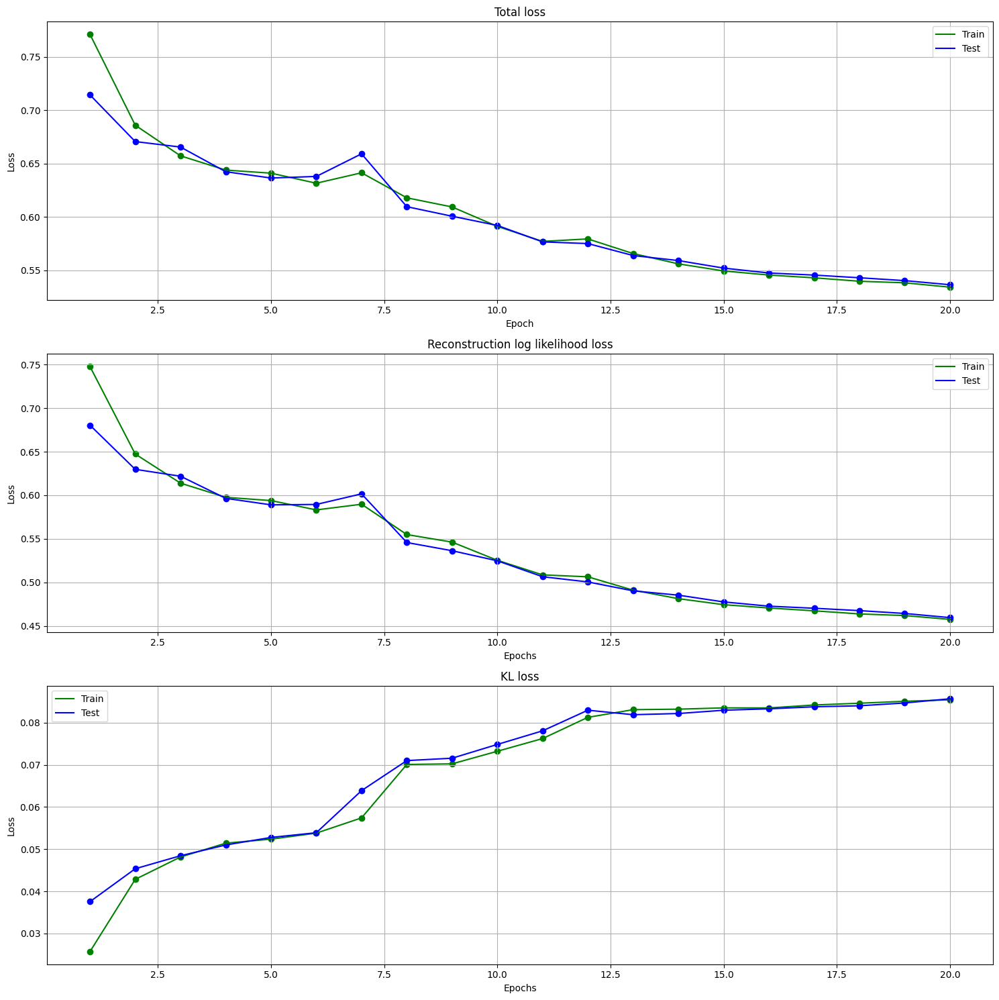

In [60]:
# *CODE FOR PART 1.2a IN THIS CELL*
# The plotting function which gets all the different losses and
# creates different graphs for each one of them
def plot_loss_curves(train_loss, train_reconstruction_loss, train_kld_loss,
               test_loss, test_reconstruction_loss, test_kld_loss, save_flag=False,name_graph=""):
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,15))
    
    epochs = [i+1 for i in range(len(test_kld_loss))]

    
    # plotting the total loss
    ax1.set_title('Total loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.plot(epochs, train_loss, color='green', label='Train')
    ax1.scatter(epochs, train_loss, color='green')
    ax1.plot(epochs, test_loss, color='blue', label='Test')
    ax1.scatter(epochs, test_loss, color='blue')
    ax1.legend()
    ax1.grid()

    # plotting the reconstruction log likelihood loss
    ax2.set_title('Reconstruction log likelihood loss')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Loss')
    ax2.plot(epochs, train_reconstruction_loss, color='green', label='Train')
    ax2.scatter(epochs, train_reconstruction_loss, color='green')
    ax2.plot(epochs, test_reconstruction_loss, color='blue', label='Test')
    ax2.scatter(epochs, test_reconstruction_loss, color='blue')
    ax2.legend()
    ax2.grid()

    # plotting the KL loss
    ax3.set_title('KL loss')
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('Loss')
    ax3.plot(epochs, train_kld_loss, color='green', label='Train')
    ax3.scatter(epochs, train_kld_loss, color='green')
    ax3.plot(epochs, test_kld_loss, color='blue', label='Test')
    ax3.scatter(epochs, test_kld_loss, color='blue')
    ax3.legend()
    ax3.grid()

    plt.tight_layout()
    if save_flag:
        plt.savefig(f"{name_graph} VAE_Losses.png")
    plt.show()
   
plot_loss_curves(total_loss_train, reconstruction_loss_train,kld_loss_train,
               total_loss_test, reconstruction_loss_test,kld_loss_test, save_flag=False,name_graph="beta:12.0")


## Part 1.2b: Samples and Reconstructions (6 Points)
Visualize a subset of the images of the test set and their reconstructions **as well as** a few generated samples. Most of the code for this part is provided. You only need to call the forward pass of the model for the given inputs (might vary depending on your implementation).

For reference, here's [some samples from our VAE](https://imgur.com/NwNMuG3).


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


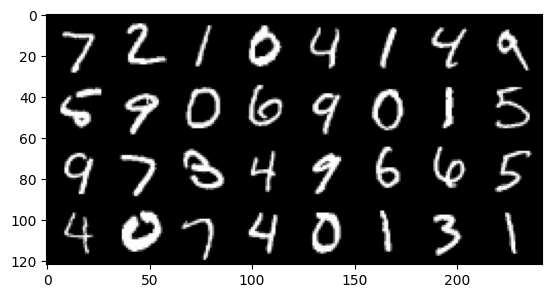

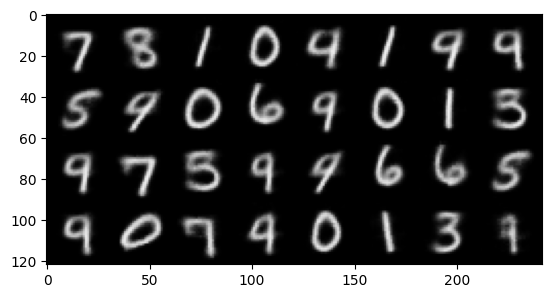

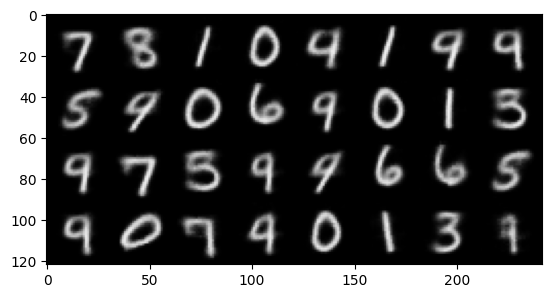

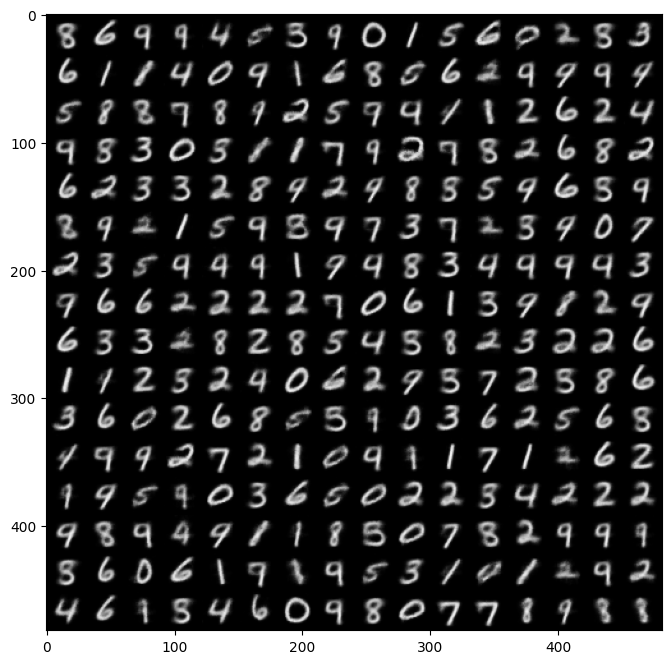

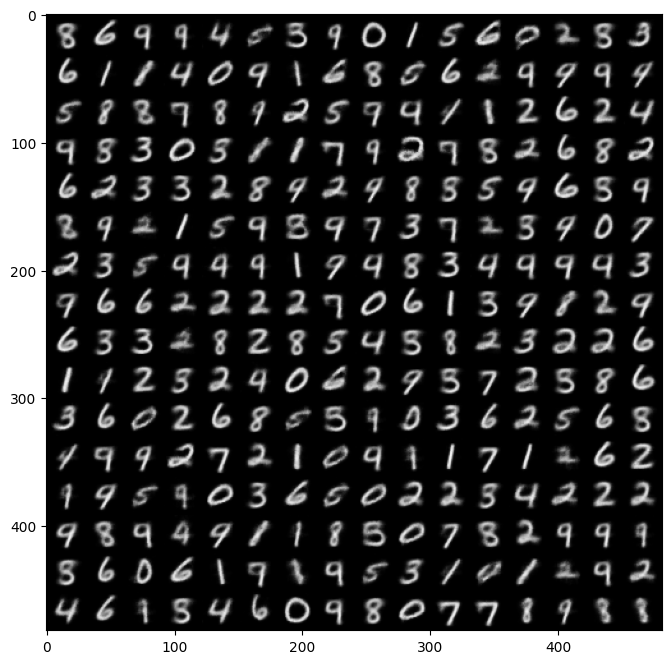

In [61]:
# *CODE FOR PART 1.2b IN THIS CELL*

# load the model
print('Input images')
print('-'*50)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[0:32, :, :, :]
# visualize the original images of the last batch of the test set
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
show(img)

print('Reconstructed images')
print('-'*50)
with torch.no_grad():
    # visualize the reconstructed images of the last batch of test set
    
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    recon_batch,temp1,temp2 =model(fixed_input)
    recon_batch = recon_batch.cpu()
    recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(recon_batch)
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    recon_batch = recon_batch.cpu()
    recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(recon_batch)

print('Generated Images')  
print('-'*50)
model.eval()
n_samples = 256
z = torch.randn(n_samples,latent_dim).to(device)
with torch.no_grad():
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    samples =model.decode(z)
    samples = samples.cpu()
    samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(samples)
    
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    samples = samples.cpu()
    samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(samples)



beta = 0.4


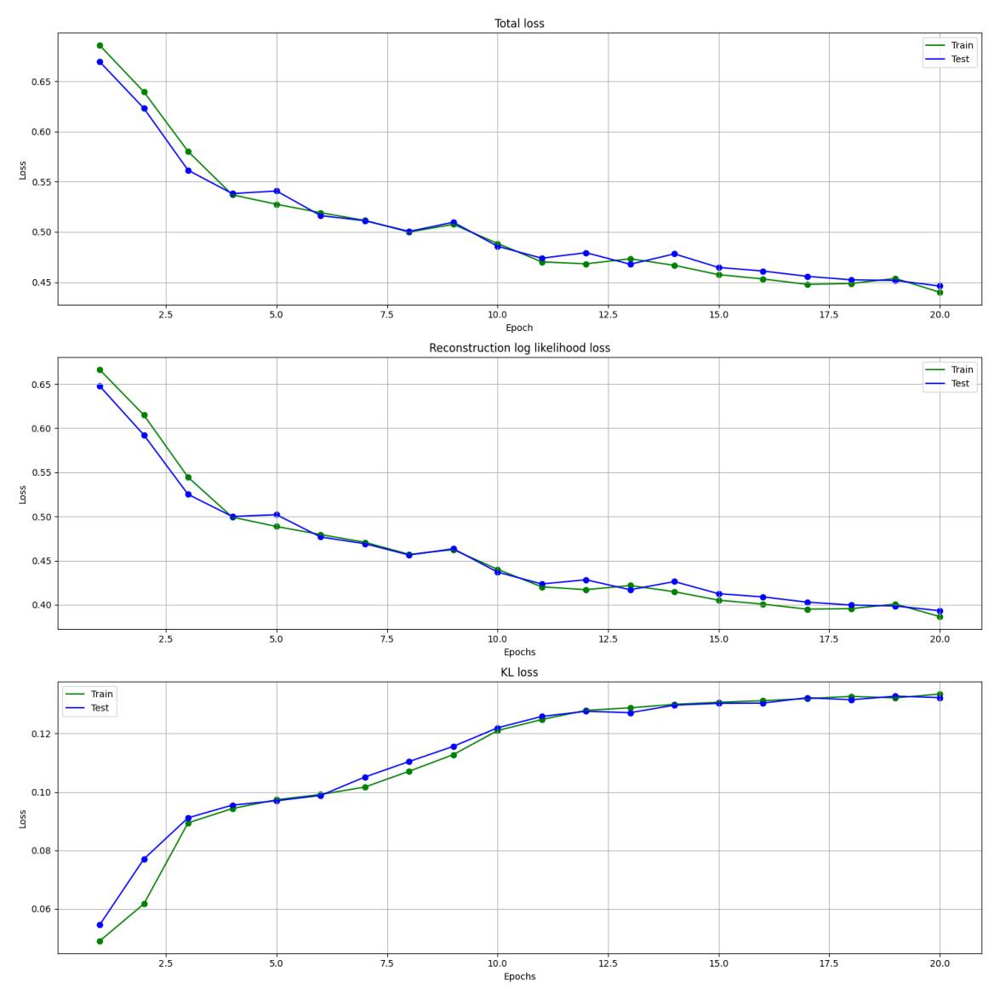

beta = 0.9


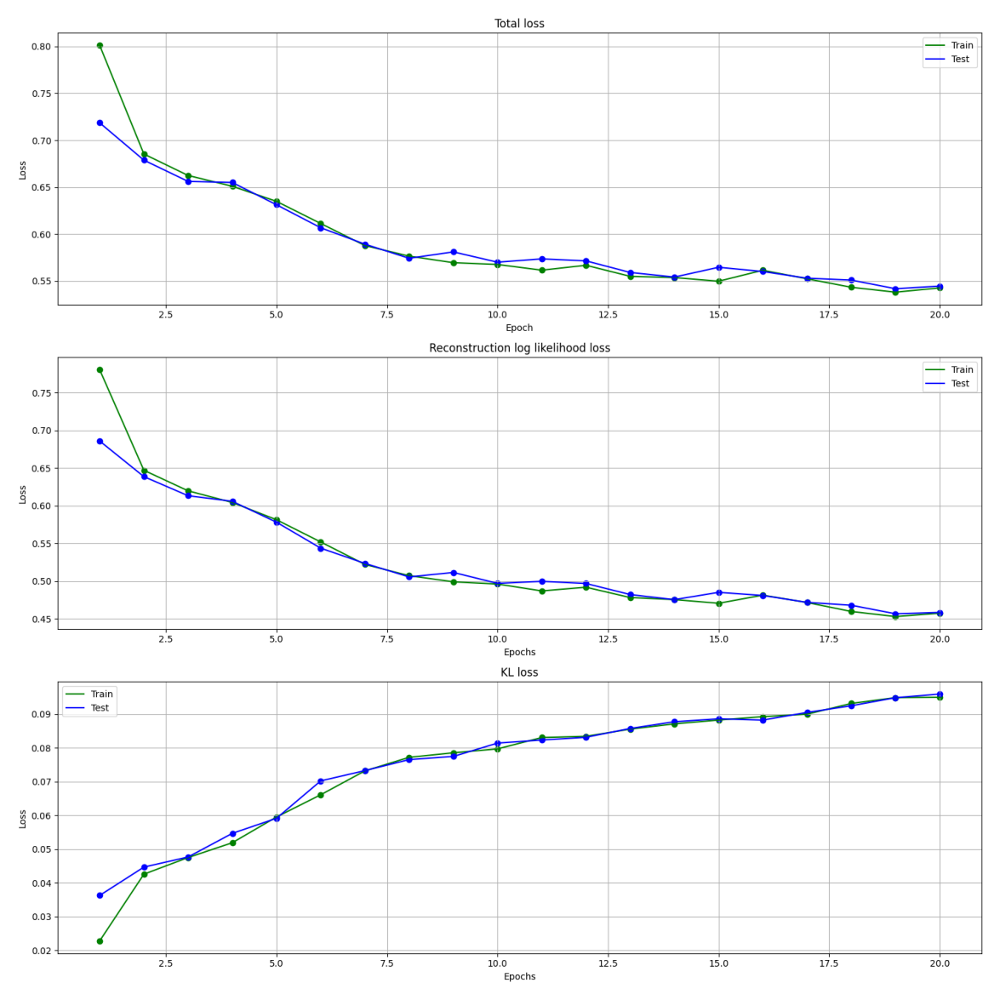

beta = 1.2


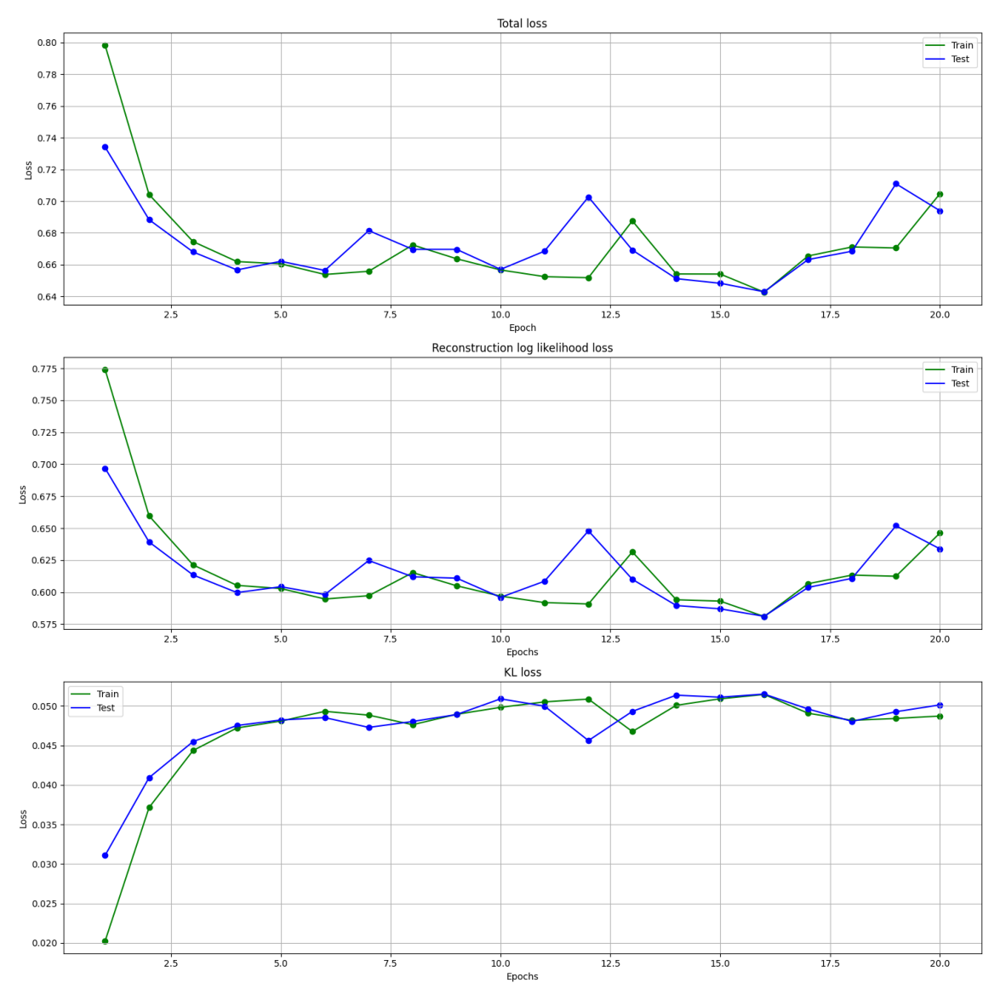

beta = 1.6


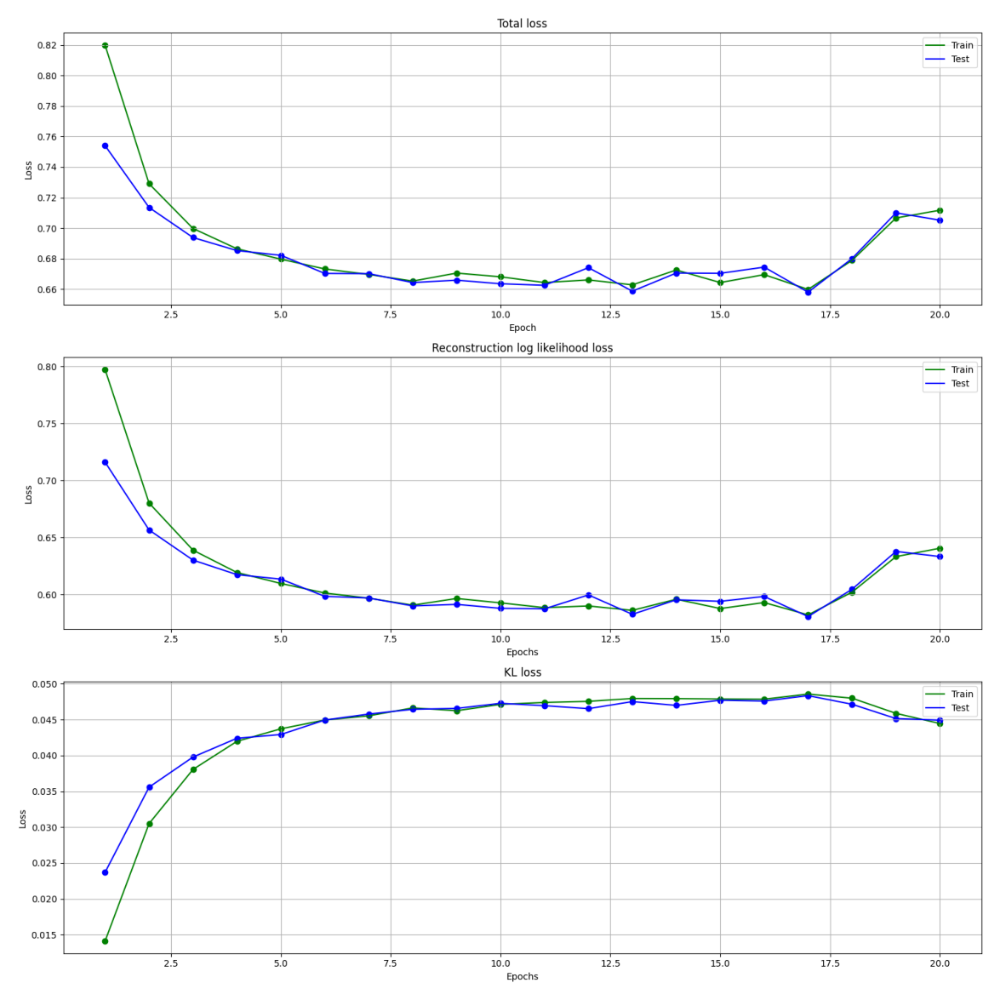

beta = 3.0


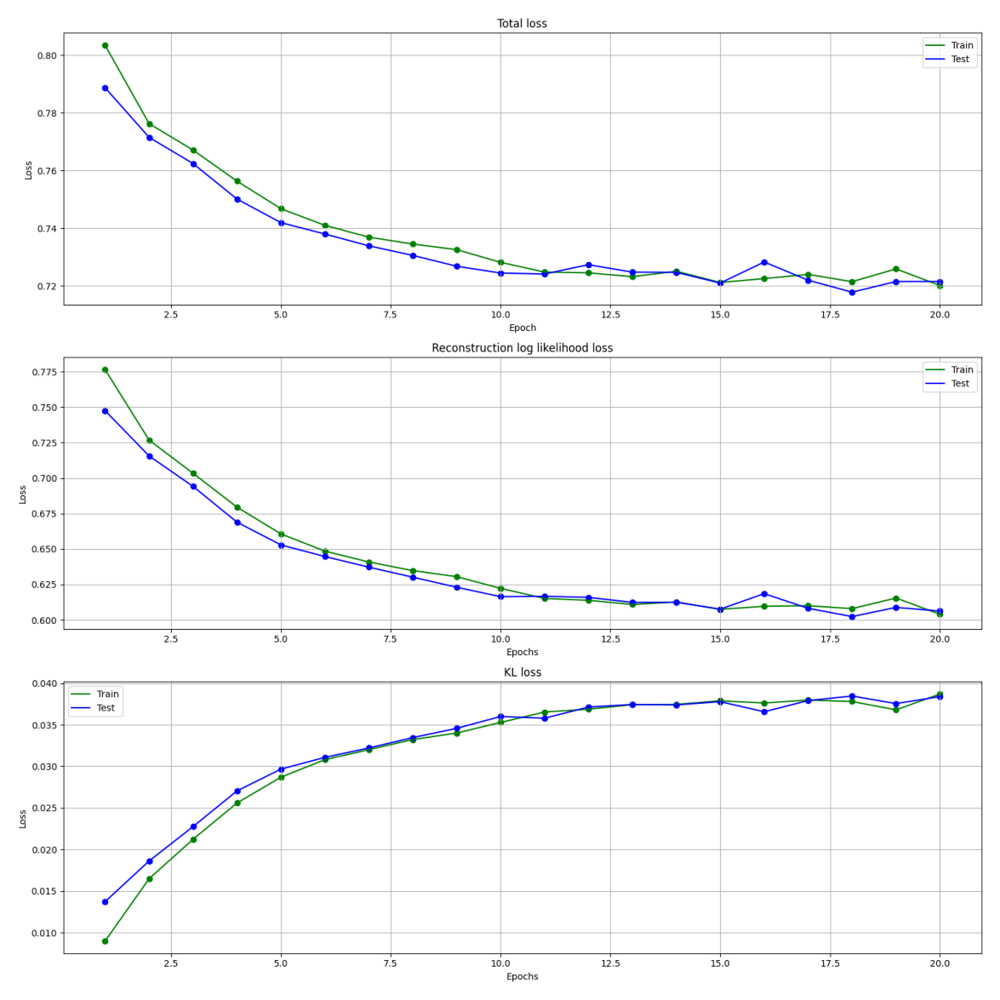

In [24]:
# This cell just loads all the images i created throughout my different experiments
# about the different values of betas. 

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
print("beta = 0.4")
img = mpimg.imread('graphs/beta:0.4 VAE_Losses.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 0.9")
img = mpimg.imread('graphs/beta:0.9 VAE_Losses.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 1.2")
img = mpimg.imread('graphs/beta:1.2 VAE_Losses.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 1.6")
img = mpimg.imread('graphs/beta:1.6 VAE_Losses.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 3.0")
img = mpimg.imread('graphs/beta:3 VAE_Losses.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

### Discussion
Provide a brief analysis of your loss curves and reconstructions: 
* What do you observe in the behaviour of the log-likelihood loss and the KL loss (increasing/decreasing)?
* Can you intuitively explain if this behaviour is desirable? 
* What is posterior collapse and did you observe it during training (i.e. when the KL is too small during the early stages of training)? 
    * If yes, how did you mitigate it? How did this phenomenon reflect on your output samples?
    * If no, why do you think that is?

**YOUR ANSWER**

All the different graphs overall follow the same trends. The log-likelihood, reconstruction, loss is
decreasing and then converges(plateaus) as shown in the first graph. On the other hand,
the KL loss is increases and then converges as displayed in the first graph. This makes sense as we can 
either decide to minimize the log-likelihood loss or increase the KL loss(formula).
So, what we actual want is to increase the KL loss, decrease the reconstruction loss and consequently
to decrease the total loss.
Posterior collapse happens during training when the model ignores the latent variables and leads to poor
reconstructions. This means that the encoder maps a lot (or even all) the input samples to a single point 
in the latent dimension,space and therefore the model is not able to geberate diverse outputs based on the
different inputs. This can be seen in the initial, early stages of training as the KL is very small
and the images are full with random pixels.
To stop this problem we implemented a regularizaiton term β to the VAE loss, in the KL term.
I tested different β values like 0.4, 0.8, 0.9, 1.2, 1.6, 3.0.
The β with values more than one does not produce stables results as the losses flunctuates in the end.
I think the best values for β are 0.4 and 0.9 but i would choose the 0.9 as it finds a balance
between a tradeoff between the the reconstruction ability and generated samples.

---
<h2> Part 1.3 (11 points) <h2/>

Qualitative analysis of the learned representations

In this question you are asked to qualitatively assess the representations that your model has learned. In particular:

a. Dimensionality Reduction of learned embeddings

b. Interpolating in the latent space

## Part 1.3a: T-SNE on Embeddings (7 Points)
Extract the latent representations of the test set and visualize them using [T-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  [(see implementation)](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html). You can use a T-SNE implementation from a library such as scikit-learn. 

We've provided a function to visualize a subset of the data, but you are encouraged to also produce a matplotlib plot (please use different colours for each digit class).

In [62]:
# *CODE FOR PART 1.3a IN THIS CELL
from sklearn.manifold import TSNE

def get_tsne(loader,model_new,perplexity_number=30):
    model_new.eval()
    latents = np.empty((0,latent_dim))
    labels = np.empty(0)

    with torch.no_grad():
        for data, label in loader:
            data = data.to(device)
            # encoding the data
            z, temp = model_new.encode(data)
            # finding the features
            latents = np.vstack([latents, z.cpu().detach().numpy()])
            labels = np.hstack([labels, label.numpy()])
    #tsne = TSNE(n_components=2,random_state=1000, init='pca', verbose=0, perplexity=40, n_iter=300)
    tsne = TSNE(n_components=2,random_state=1000, init='pca', verbose=0, perplexity=perplexity_number, n_iter=300)
    
    return tsne.fit_transform(latents),labels



In [63]:
# Interactive Visualization - Code Provided
test_data_loader = DataLoader(test_dat, 10000, shuffle=False)

z_embedded,labels=get_tsne(test_data_loader,model,300)

""" Inputs to the function are
        z_embedded - Embedded X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""
# print("embed size",z_embedded.shape)
# for batch in test_data_loader:
#     inputs, labels = batch
#     print(f"Input batch shape: {inputs.shape}")
#     print(f"Labels batch shape: {labels.shape}")
#     break  # Exit after the first batch
    
plot_tsne(z_embedded, test_data_loader, num_points=1000, darkmode=False)



/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


alt.HConcatChart(...)

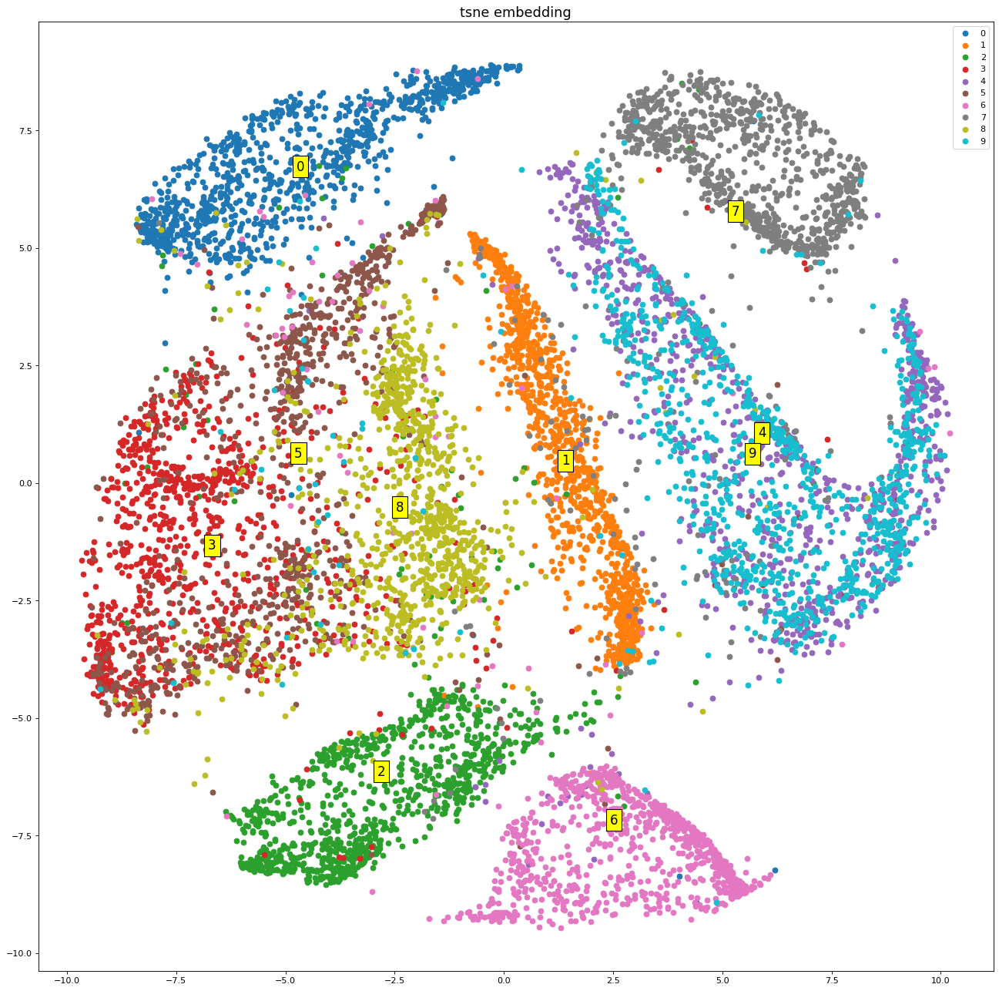

In [64]:
# Custom Visualizations
        

def plot_tsne_embeddings(z_embedded, labels,save_flag=False,graph_name=""):
    plt.figure(figsize=(20, 20), dpi= 80, facecolor='w', edgecolor='b')
    col_map = plt.get_cmap("tab10").colors
    for i, c in enumerate(col_map):
        x_labels = z_embedded[labels == i,0]
        y_labels = z_embedded[labels == i,1]
        plt.scatter(x_labels, y_labels, label = str(i))
        plt.text(np.mean(z_embedded[labels == i,0]), 
             np.mean(z_embedded[labels == i,1]), str(i), 
             ha="center", va="center", size=15,
             bbox=dict(boxstyle="square,pad=0.3", facecolor='yellow'))

    plt.title("tsne embedding", fontsize=16)  
    plt.legend()
    if save_flag:
        plt.savefig(f"{graph_name} vae_tsne_embedding.png")        
    plt.show()


#plot_tsne_embeddings(z_embedded, labels,save_flag=False,graph_name="beta:12.0")
 
plot_tsne_embeddings(z_embedded, labels,save_flag=False,graph_name="perpl: 300")

beta = 0.4


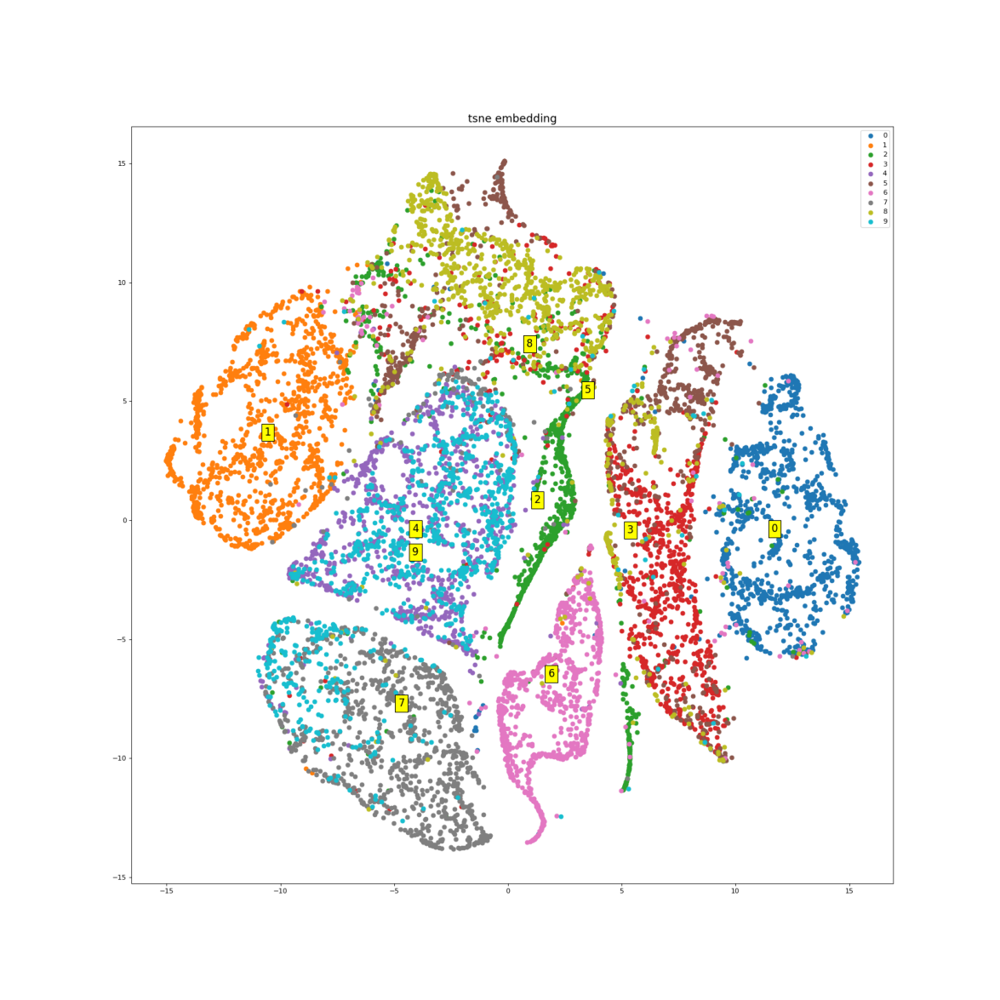

beta = 0.9


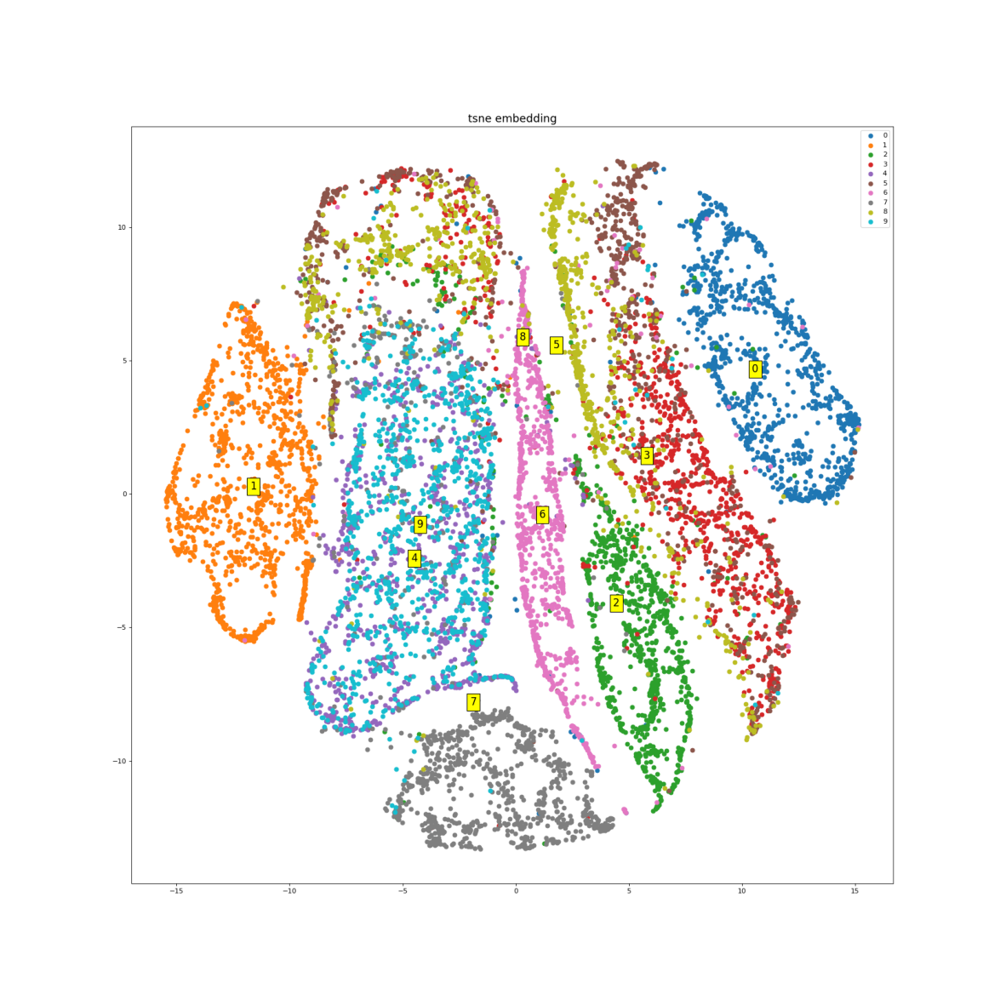

beta = 1.2


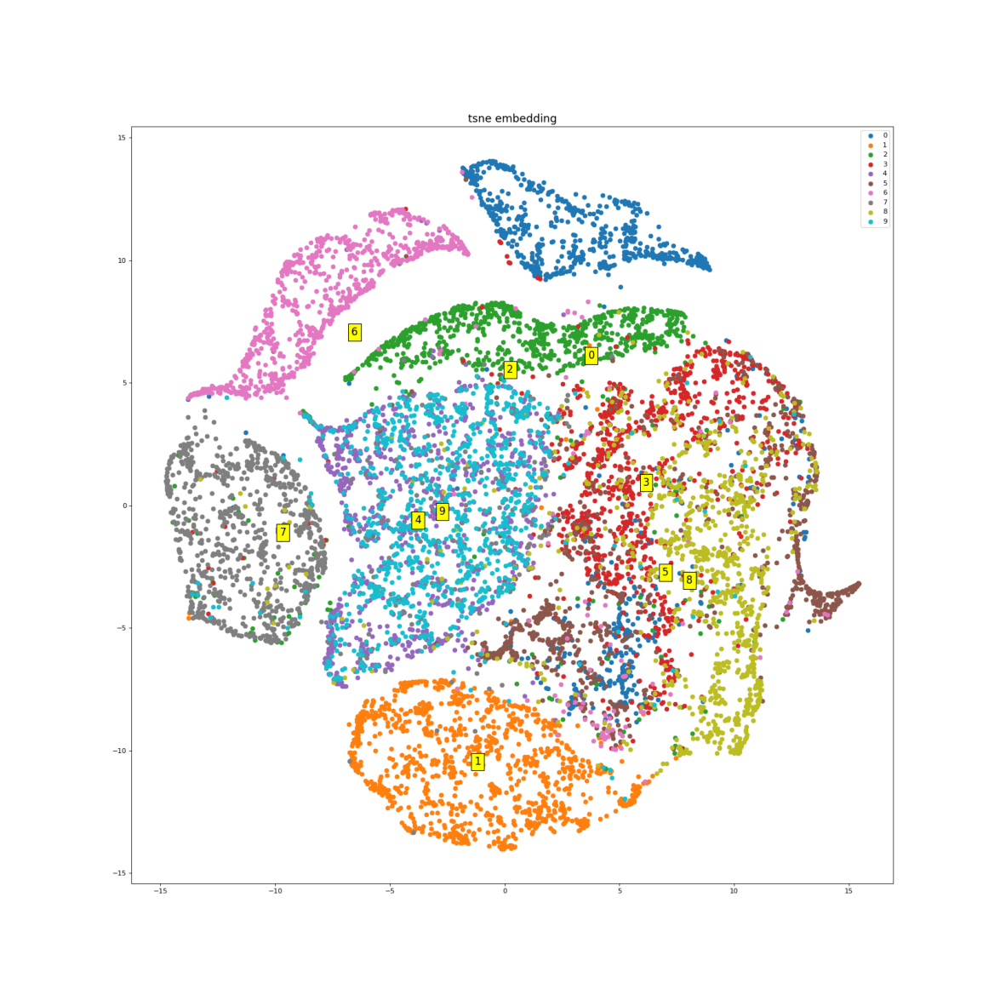

beta = 1.6


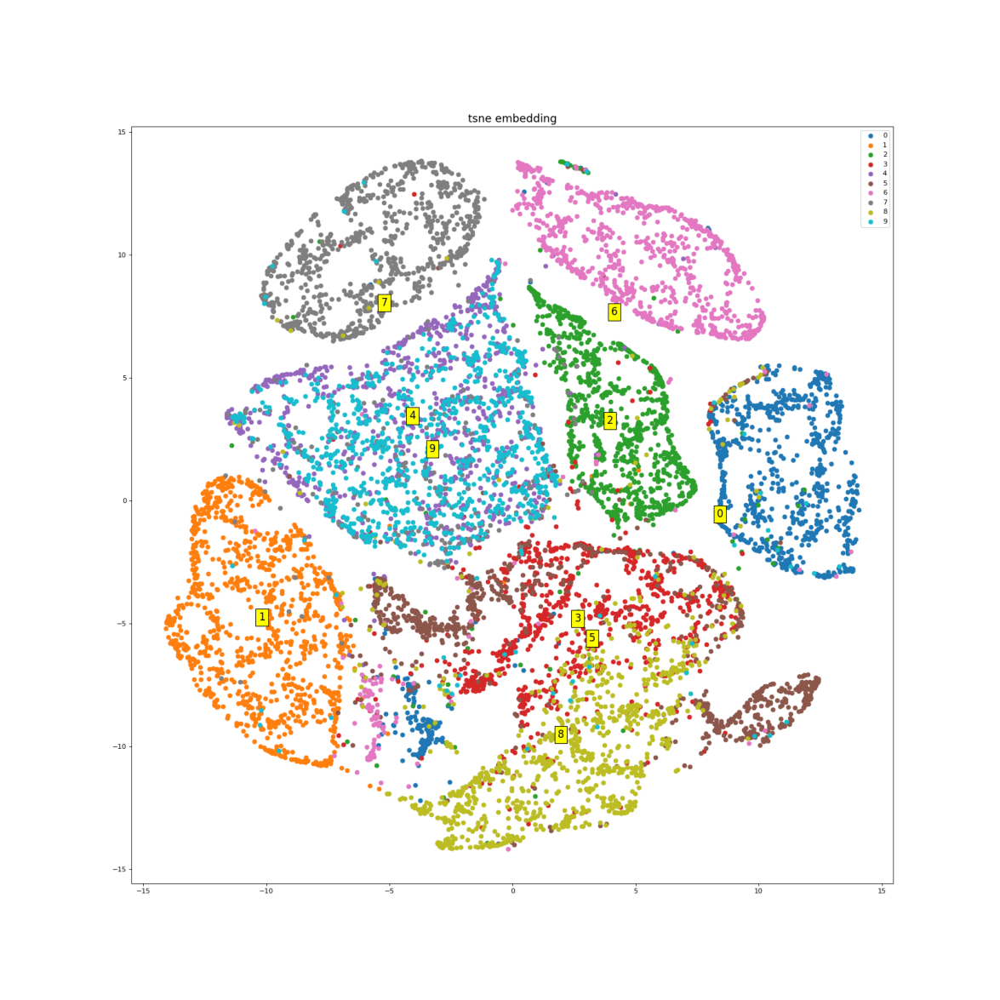

beta = 3.0


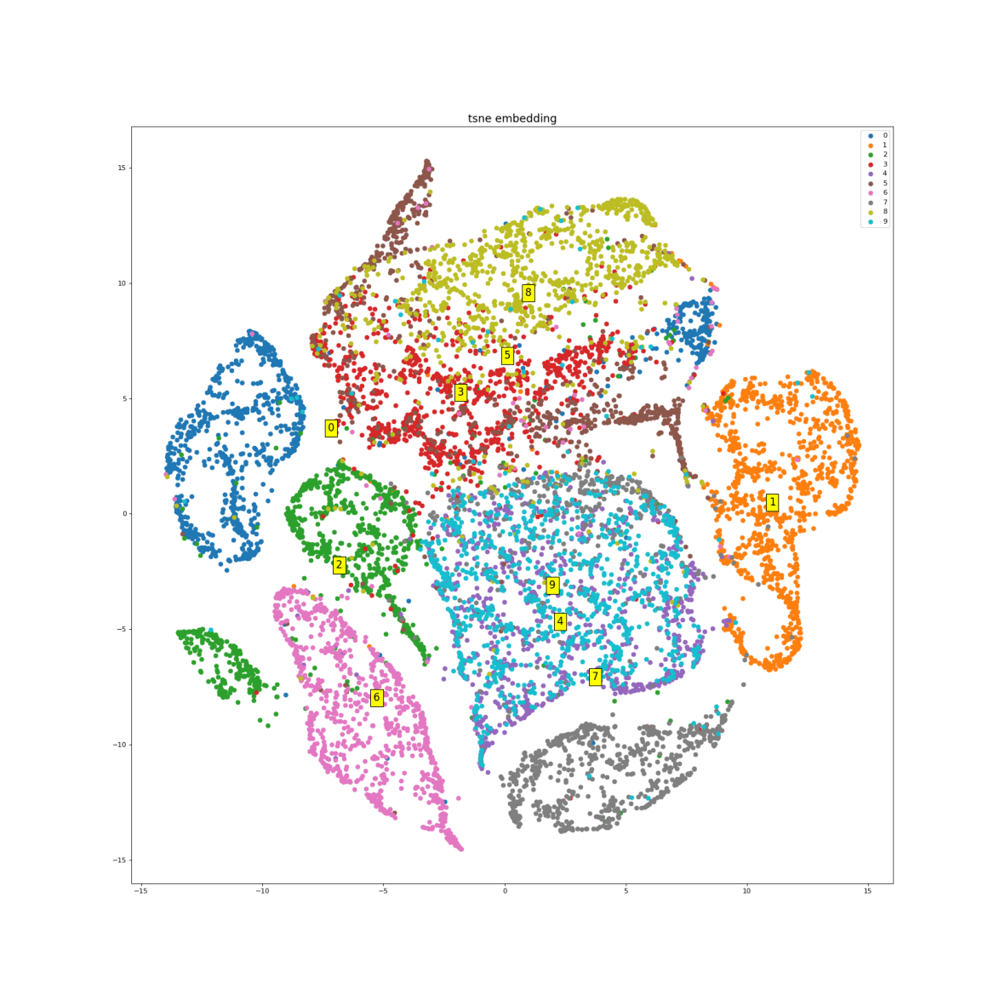

beta = 12.0


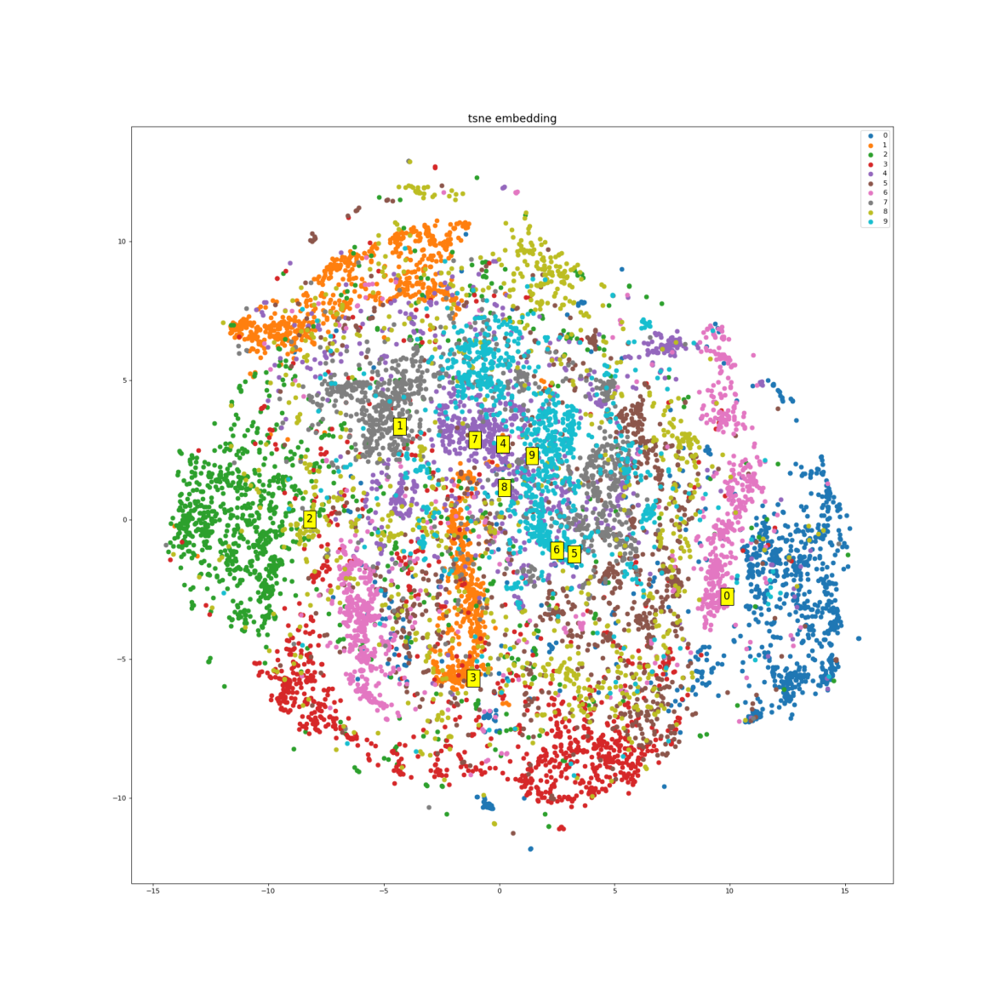

In [69]:
# plot all the graphs i created. These are for different betas
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
print("beta = 0.4")
img = mpimg.imread('graphs/beta:0.4 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 0.9")
img = mpimg.imread('graphs/beta:0.9vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 1.2")
img = mpimg.imread('graphs/beta:1.2 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 1.6")
img = mpimg.imread('graphs/beta:1.6 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 3.0")
img = mpimg.imread('graphs/beta:3 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("beta = 12.0")
img = mpimg.imread('graphs/beta:12.0 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

t-sne for my best beta=0.9

Perplexity : 2


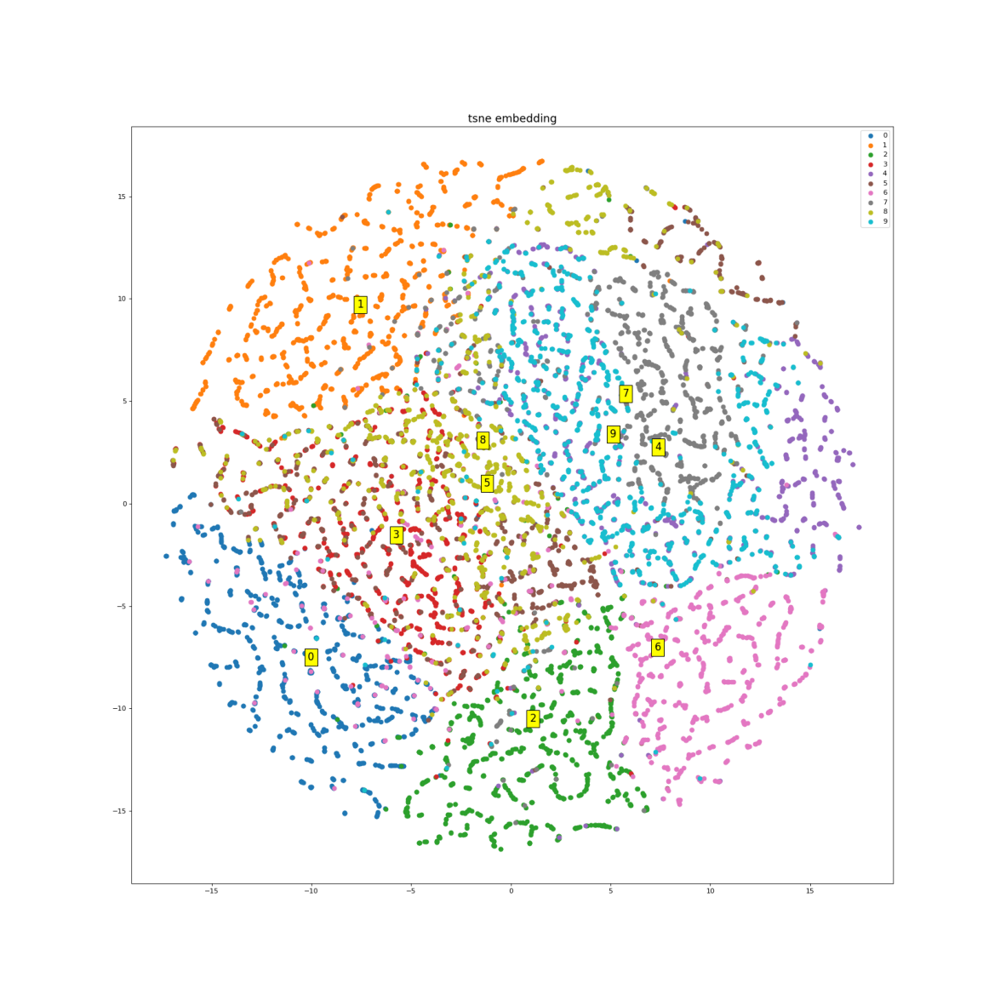

Perplexity : 10


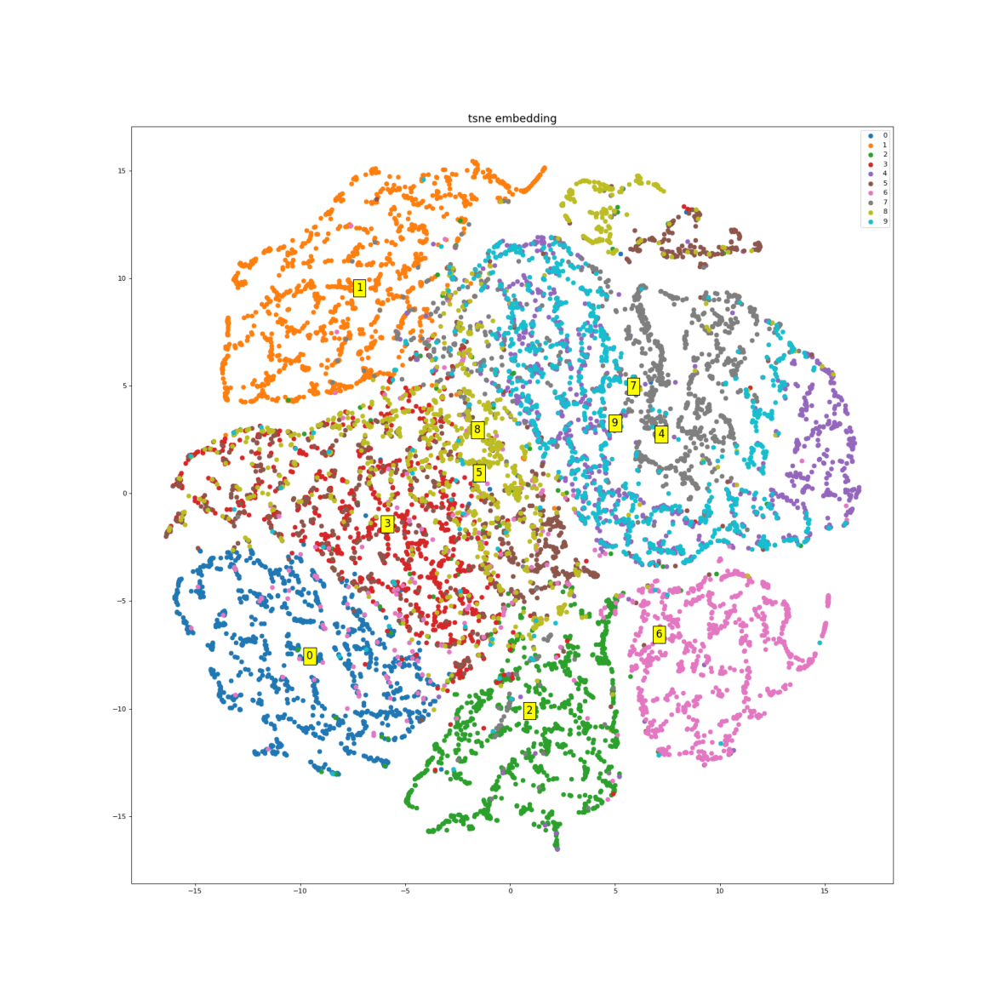

Perplexity : 20


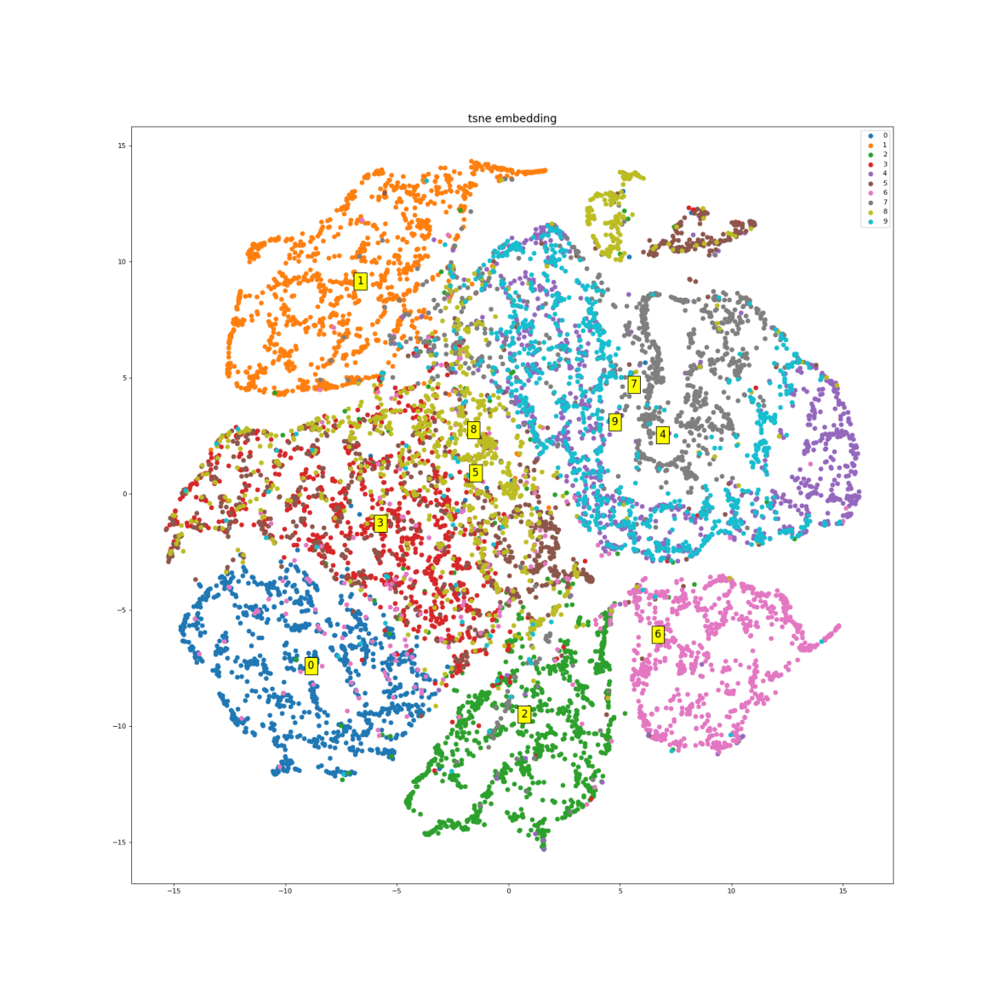

Perplexity : 30


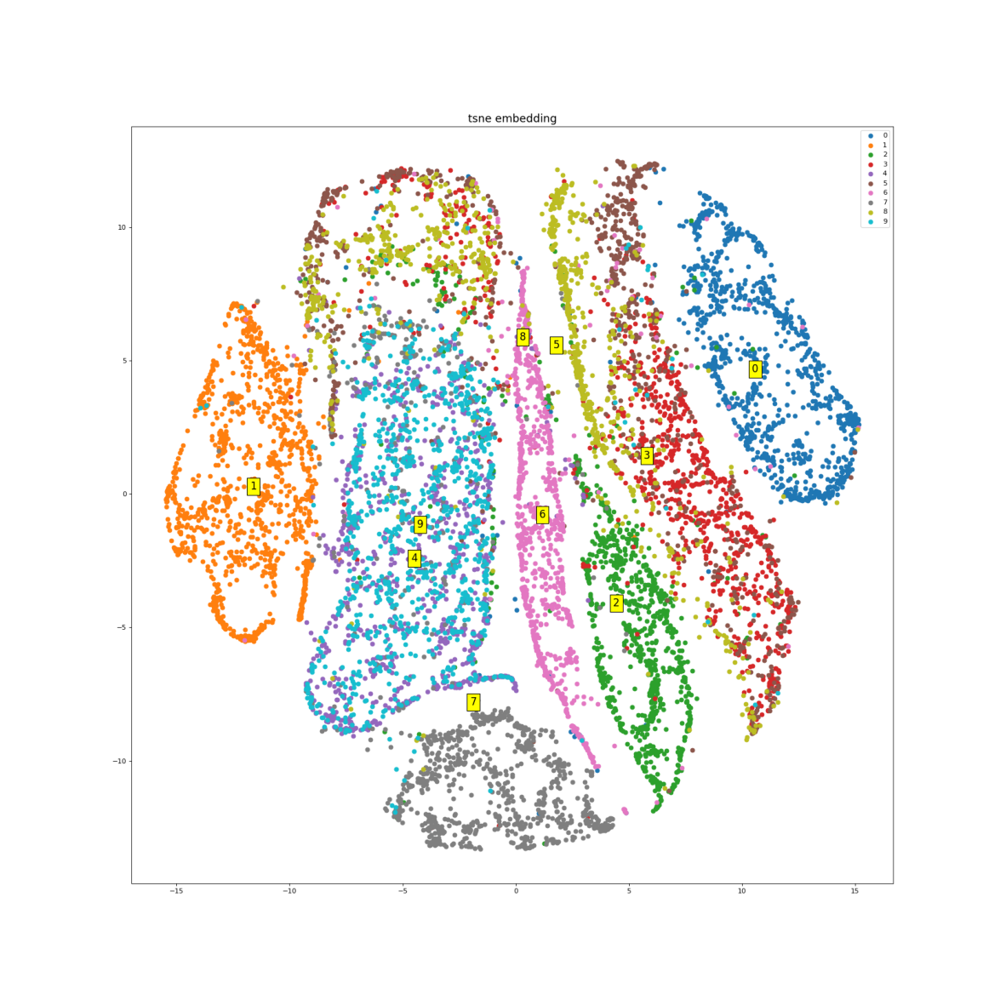

Perplexity : 100


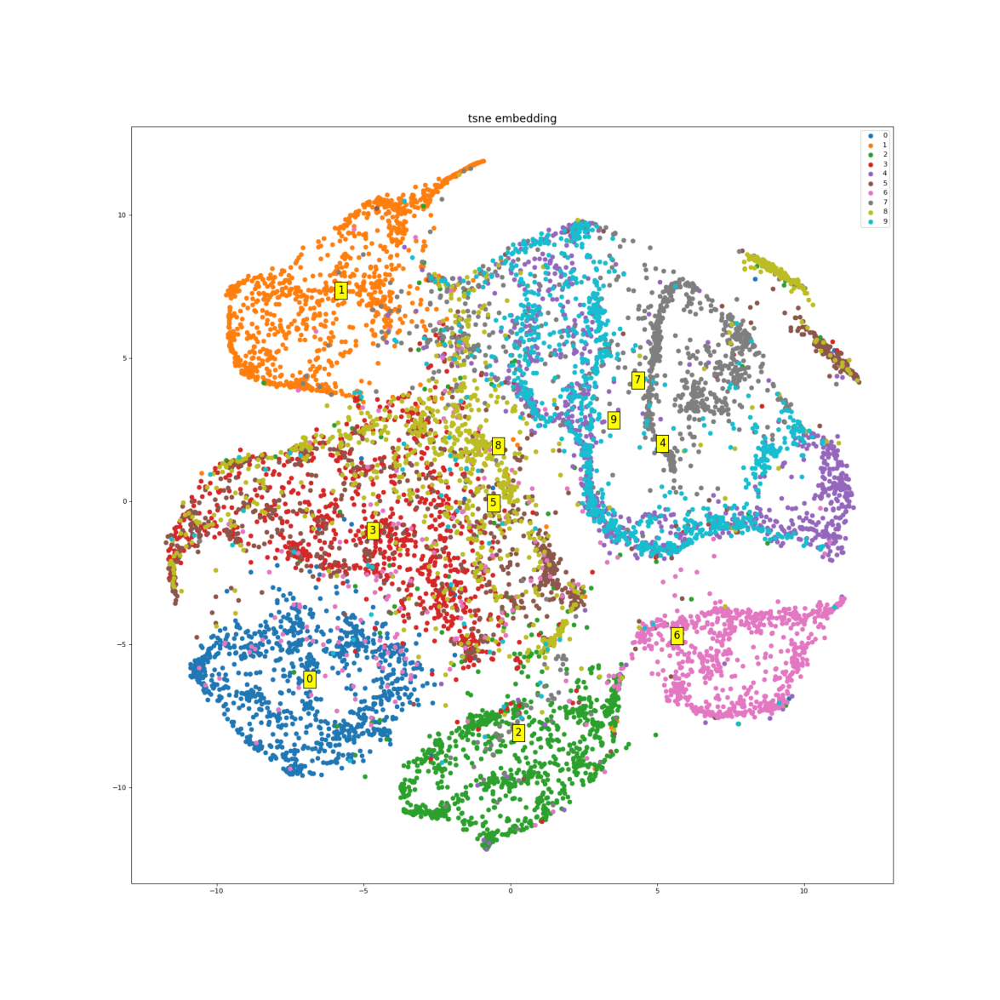

Perplexity : 300


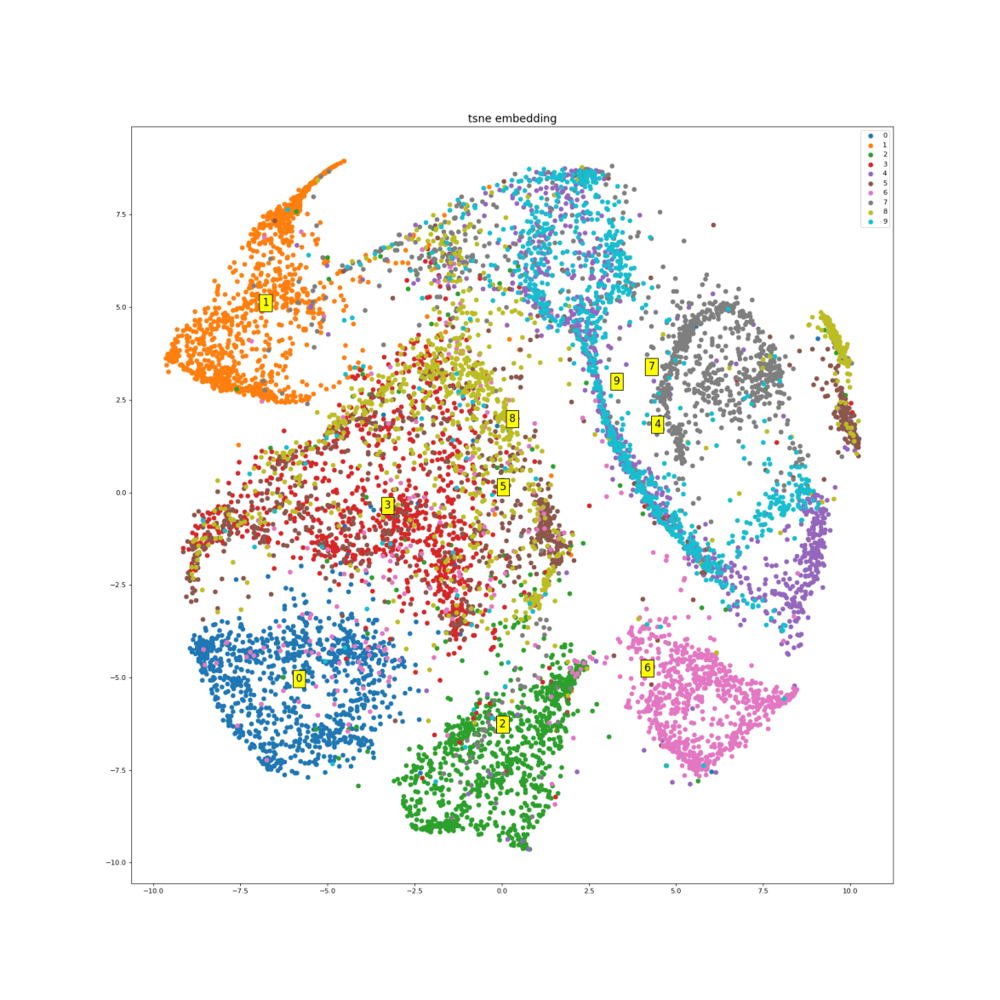

In [93]:
# Graphs for the beta equal to 0.9 a(as it was the best). These are for different perplexity values
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
print("t-sne for my best beta=0.9\n")

print("Perplexity : 2")
img = mpimg.imread('graphs/perpl: 2 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("Perplexity : 10")
img = mpimg.imread('graphs/perpl: 10 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("Perplexity : 20")
img = mpimg.imread('graphs/perpl: 20 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("Perplexity : 30")
img = mpimg.imread('graphs/perpl: 30 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("Perplexity : 100")
img = mpimg.imread('graphs/perpl: 100 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

print("Perplexity : 300")
img = mpimg.imread('graphs/perpl: 300 vae_tsne_embedding.png')
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.axis('off')
plt.show()

### Discussion
What do you observe? Discuss the structure of the visualized representations. 
* What do you observe? What role do the KL loss term and $\beta$ have, if any, in what you observe (multiple matplotlib plots may be desirable here)?
    * Consider Outliers
    * Counsider Boundaries
    * Consider Clusters
* Is T-SNE reliable? What happens if you change the parameters (don't worry about being particularly thorough). [This link](https://distill.pub/2016/misread-tsne/) may be helpful.

Note - If you created multiple plots and want to include them in your discussion, the best option is to upload them to (e.g.) google drive and then embed them via a **public** share link. If you reference local files, please include these in your submission zip, and use relative pathing if you are embedding them (with the notebook in the base directory)

**YOUR ANSWER**

T-SNE visualizes the high dimensional features in 2 dimensions,using dimensionality
reduciton alogirhtms(like PCA in our case), so we may be able to actually 
understand and get an idea about the data. The same digits are clustered together, except
some outliers in some of the cases. This is very logical as the data points with the same
label, digit should be close to each other, and belong to the same or a close cluster.
Also, we can see that logits that seem similar to each other are actually clustered close,
like 4 and 9 as can be seen in the first image.

As i explained in the previous quesiton the β is a regularizer for the KL loss and i tried several
values of β  like 0.4, 0.9, 1.2, 1.6 and 12 (as an edge test case). For each one of these tests
i made the T-SNE plots as can be seen above. 
From the plots we can see that for β 0.4 has the less outliers and when i increase it to 0.9
the number of outliers increases.
Throughout all the different β we can notice that 4 and 9 are very close and do not have actual cluster
of themselves but for higher β (1.2, 1.6) the numbers 3,5 and 8 are also overlapping.
Finally for the edge case of β equal to 12 we can see that all the logits are overlapping,
there are many outliers, and we cannot actually seperate it and see the different clusters.

To test the reliability of the T-SNE i tried many different values for its main hyperparameter which is the Perplexity. I tried the values
of 2,10,20,30,100 and 300. Throughout the different values we can see different cluster sizes and shapes. Also, we can notice that the spatial
position of each logit, label remains the same and that when we increase the perplexity variable the clusters become more overlapping,
as their perplexity is increased as the name of the variable suggests. 
I believe the T-SNE, figures is reliable and provides a good image, idea of the higher dimensional data especially for perplexity greater,equal than
30. On the other hand, there are a lot of different hyperparameters for this plot that can change drastically the illustration, figure.
Finally, the T-SNE provides a sub-optimal solution so we cannot be fully certain that its a good sub-optimal as it is not the actual
optimal result, so it can be used in combination with other analysis methods to increase our certainty.
 



## Part 1.3b: Interpolating in $z$ (4 Points)
Perform a linear interpolation in the latent space of the autoencoder by choosing any two digits from the test set. What do you observe regarding the transition from on digit to the other?

_hint: Locate the positions in latent space of 2 data points (maybe a one and an eight). Then sample multiple latent space vectors along the line which joins the 2 points and pass them through the decoder._


/usr/local/lib/python3.9/dist-packages/torchvision/utils.py:68: UserWarning: The parameter 'range' is deprecated since 0.12 and will be removed in 0.14. Please use 'value_range' instead.
  warnings.warn(


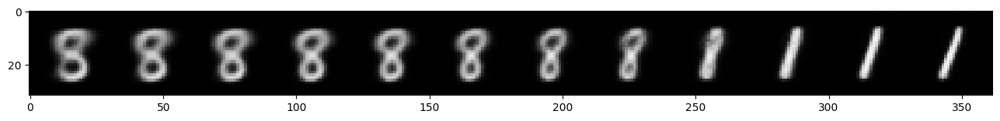

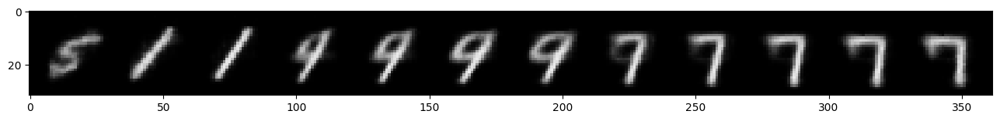

In [65]:
# CODE FOR PART 1.3b IN THIS CELL
def show_interpolation_two_points(x1,x2):
    mu1,logvar1=model.encode(x1.to(device))
    mu2,logvar2=model.encode(x2.to(device))
    z1=model.reparametrize(mu1,logvar1)
    z2=model.reparametrize(mu2,logvar2)
    interpolation_values = np.linspace(0,1,num=12)
    latent= torch.tensor([]).to(device)
    for interpolation in interpolation_values:
        z=interpolation *z1+(1-interpolation)*z2
        latent=torch.cat((latent,z),0)
    samples=model.decode(latent).cpu()
    grid_samples=make_grid(denorm(samples),nrow=12,padding=2,normalize=False,range=None,
                           scale_each=False,pad_value=0)
    plt.figure(figsize = (16,16))
    show(grid_samples)
    
                           
# get testing data
test_dataloader = DataLoader(test_dat, batch_size=100, shuffle=False)
test_data, test_labels = next(iter(test_dataloader))
# for i,num in enumerate(test_labels):
#     print(i," ",num)

# number 1:
x1=torch.FloatTensor(test_data[89]).reshape(1,1,28,28)
# number 8:
x2=torch.FloatTensor(test_data[84]).reshape(1,1,28,28)
show_interpolation_two_points(x1,x2)

#number 7
x3=torch.FloatTensor(test_data[26]).reshape(1,1,28,28)
# number 5 
x4=torch.FloatTensor(test_data[59]).reshape(1,1,28,28)
show_interpolation_two_points(x3,x4)



### Discussion
What did you observe in the interpolation? Is this what you expected?
* Can you relate the interpolation to your T-SNE visualization

Answer:
(The T-SNE that is used for this explanation is the actual T-SNE of the current
model and not the "testing T-SNEs i import from the images, as i have to 
use the real one for the current model for my explanations)



In the first figure we can see that the image/digit moves from the digit 8 to 1.
We interpolated 12 images and the number one starts appearing in image 9
and is fully shown in image 11. We expected this as we move between 2 latent
representations in the latent space and the one digit starts to transfmorm
into the other slowly.
To correlate it with the T-SNE we can see that it moves from the cluster of 8's,
in the middle up to the cluster of ones which is on its right.
I also transformed 5 into 7 as we can see in the second image
and it goes from 5 is transformed to 1, then 9 and finally into 
the 7 in the image 10. This is actually correlated and can be seen in the T-SNE
as it seems that it starts from the cluster of 5 in the middle(little left), 
then goes on 1 a little bit lower on the right(orange colour), 
then goes to 9 which is on its right and goes above that where is the
cluster of 7.
So, it is easy to explain the visualization through the T-SNE as it seems to be
moving in the visualization to actually create the final logit we want,
i.e. the 1 and 7 in our case.



**YOUR ANSWER**

# Part 2 - Deep Convolutional GAN

In this task, your main objective is to train a DCGAN (https://arxiv.org/abs/1511.06434) on the CIFAR-10 dataset. You should experiment with different architectures and tricks for stability in training (such as using different activation functions, batch normalization, different values for the hyper-parameters, etc.). In the end, you should provide us with: 

- your best trained model (which we will be able to load and run), 
- some generations for the fixed latent vectors $\mathbf{z}\sim \mathcal{N}\left(\mathbf{0}, \mathbf{I}\right)$ we have provided you with (train for a number of epochs and make sure there is no mode collapse), 
- plots with the losses for the discriminator $D$ and the generator $G$ as the training progresses and explain whether your produced plots are theoretically sensible and why this is (or not) the case. 
- a discussion on whether you noticed any mode collapse, where this behaviour may be attributed to, and explanations of what you did in order to cope with mode collapse. 

## Part 2.1 (30 points)
**Your Task**: 

a. Implement the DCGAN architecture. 

b. Define a loss and implement the Training Loop

c. Visualize images sampled from your best model's generator ("Extension" Assessed on quality)

d. Discuss the experimentations which led to your final architecture. You can plot losses or generated results by other architectures that you tested to back your arguments (but this is not necessary to get full marks).


_Clarification: You should not be worrying too much about getting an "optimal" performance on your trained GAN. We want you to demonstrate to us that you experimented with different types of DCGAN variations, report what difficulties transpired throughout the training process, etc. In other words, if we see that you provided us with a running implementation, that you detail different experimentations that you did before providing us with your best one, and that you have grapsed the concepts, you can still get good marks. The attached model does not have to be perfect, and the extension marks for performance are only worth 10 points._

In [162]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.optim.lr_scheduler import StepLR, MultiStepLR
import torch.nn.functional as F
import matplotlib.pyplot as plt

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
# trying different Standard deviations for the unormalzie to find the best one
# std = torch.Tensor([0.247, 0.243, 0.261])
# previous default std
#std = torch.Tensor([0.65, 0.65, 0.65])
# my std
std = torch.Tensor([0.45, 0.45, 0.45])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x, channels=None, w=None ,h=None, resize = False):
    
    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_GAN'):
    os.makedirs(content_path/'CW_GAN')

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

Using cuda


### Part 2.1a: Implement DCGAN (8 Points)
Fill in the missing parts in the cells below in order to complete the Generator and Discriminator classes. You will need to define:

- The hyperparameters
- The constructors
- `decode`
- `discriminator`

Recomendations for experimentation:
- use the architecture that you implemented for the Autoencoder of Part 1 (encoder as discriminator, decoder as generator).
- use the architecture desribed in the DCGAN paper (https://arxiv.org/abs/1511.06434).

Some general reccomendations:
- add several convolutional layers (3-4).
- accelerate training with batch normalization after every convolutional layer.
- use the appropriate activation functions. 
- Generator module: the upsampling can be done with various methods, such as nearest neighbor upsampling (`torch.nn.Upsample`) or transposed convolutions(`torch.nn.ConvTranspose2d`). 
- Discriminator module: Experiment with batch normalization (`torch.nn.BatchNorm2d`) and leaky relu (`torch.nn.LeakyReLu`) units after each convolutional layer.

Try to follow the common practices for CNNs (e.g small kernels, max pooling, RELU activations), in order to narrow down your possible choices.

<font color="red">**Your model should not have more than 25 Million Parameters**</font>

The number of epochs that will be needed in order to train the network will vary depending on your choices. As an advice, we recommend that while experimenting you should allow around 20 epochs and if the loss doesn't sufficiently drop, restart the training with a more powerful architecture. You don't need to train the network to an extreme if you don't have the time.

#### Data loading

In [163]:

batch_size = 128   # change that


transform = transforms.Compose([
     transforms.ToTensor(),
     transforms.Normalize(mean=mean, std=std),                        
])
# note - data_path was initialized at the top of the notebook
cifar10_train = datasets.CIFAR10(data_path, train=True, download=True, transform=transform)
cifar10_test = datasets.CIFAR10(data_path, train=False, download=True, transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=batch_size)
loader_test = DataLoader(cifar10_test, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


We'll visualize a subset of the test set: 

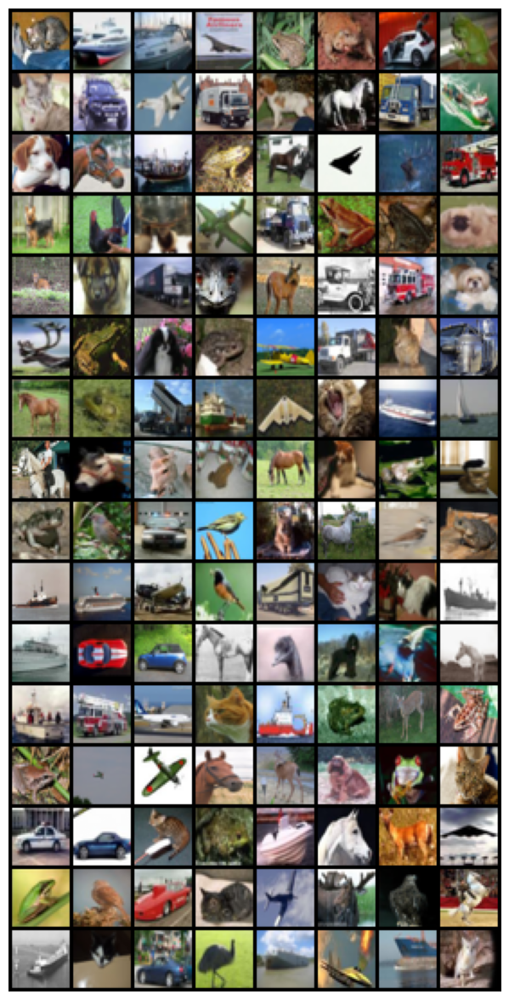

In [164]:
samples, _ = next(iter(loader_test))

samples = samples.cpu()
samples = make_grid(denorm(samples), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize = (15,15))
plt.axis('off')
show(samples)

#### Model Definition
Define hyperparameters and the model

In [165]:
# *CODE FOR PART 2.1 IN THIS CELL*

# Choose the number of epochs, the learning rate
# and the size of the Generator's input noise vetor.

# change this!! #################


#num_epochs = 20
num_epochs = 100

# learning_rate = 0.000001

#learning_rate = 0.00001

learning_rate = 0.0001
#latent_vector_size = 100 

latent_vector_size = 158 

#other hyperparams
channels=32

channels_out=3 # as we have RGB images data





In [167]:
# *CODE FOR PART 2.1 IN THIS CELL*


class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        self.gen_architecture=nn.Sequential(
            # ->latent_vector_size x 1 x 1
            nn.ConvTranspose2d(latent_vector_size,channels* 16, 6, 1, 1, bias=False),
            nn.BatchNorm2d(channels * 16),
            nn.ReLU(True),

            nn.ConvTranspose2d(channels * 16, channels * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d( channels * 8, channels * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels * 4),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(channels * 4, channels_out, 2, 2, 0, bias=False),
            nn.Tanh()
            # ->(channels_out) x 32 x 32``  
        )
        

        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

    # You can modify the arguments of this function if needed
    def forward(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        out=self.gen_architecture(z)
        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################
        return out


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        self.dis_architecture=nn.Sequential(
            
            # input->channels_out x 32 x 32 =3x32x32
            nn.Conv2d(channels_out, channels*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels*4),
            nn.LeakyReLU(0.2, inplace=True),
            #nn.ReLU(True),
            
            #nn.Dropout(p=0.5),
            nn.Dropout(p=0.2),
            
            # ->(channels*4) x 16 x 16
            nn.Conv2d(channels*4, channels*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels*8),
            nn.LeakyReLU(0.2, inplace=True),            
            #nn.ReLU(True),
            
            #nn.Dropout(p=0.5),
            nn.Dropout(p=0.2),

   
            # ->(channels*8) x 8 x 8
            nn.Conv2d(channels*8, channels * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels*16),
            nn.LeakyReLU(0.2, inplace=True),
            #nn.ReLU(True),
  
            #nn.Dropout(p=0.5),
            nn.Dropout(p=0.2),

            
            # ->(channels*16) x 4 x 4
            nn.Conv2d(channels*16, channels * 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channels*32),
            nn.LeakyReLU(0.2, inplace=True),
            #nn.ReLU(True),
           
            #nn.Dropout(p=0.5),
            nn.Dropout(p=0.2),

            
            # ->(channels*32) x 4 x 4
            nn.Conv2d(channels*32, channels * 64, 2, 1, 1, bias=False),
            nn.BatchNorm2d(channels*64),
            nn.LeakyReLU(0.2, inplace=True),
            #nn.ReLU(True),
            
            #nn.Dropout(p=0.5),
            nn.Dropout(p=0.2),
              
            # ->(channels*64) x 3 x 3
            nn.Conv2d(channels*64, 1, 3, 1, 0, bias=False),
            
            # to predict in the range of 0 and 1 i use the sigmooid activation function
            nn.Sigmoid()
        )
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
    # You can modify the arguments of this function if needed
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        out=self.dis_architecture(x)
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
        return out


<h2> Initialize Model and print number of parameters </h2>

You can use method `weights_init` to initialize the weights of the Generator and Discriminator networks. Otherwise, implement your own initialization, or do not use at all. You will not be penalized for not using initialization.

In [168]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)
        

In [170]:
use_weights_init = True

model_G = Generator().to(device)
if use_weights_init:
    model_G.apply(weights_init)
params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
print("Total number of parameters in Generator is: {}".format(params_G))
print(model_G)
print('\n')

model_D = Discriminator().to(device)

if use_weights_init:
    model_D.apply(weights_init)
params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
print("Total number of parameters in Discriminator is: {}".format(params_D))
print(model_D)
print('\n')
print("Total number of parameters is: {}".format(params_G + params_D))

Total number of parameters in Generator is: 5537024
Generator(
  (gen_architecture): Sequential(
    (0): ConvTranspose2d(158, 512, kernel_size=(6, 6), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 3, kernel_size=(2, 2), stride=(2, 2), bias=False)
    (10): Tanh()
  )
)


Total number of parameters in Discriminator is: 19431168
Discriminator(
  (dis_architecture): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), 

### Part 2.1b: Training the Model (12 Points)

#### Defining a Loss

In [171]:
# You can modify the arguments of this function if needed
def loss_function(out,label):
    criterion = nn.BCELoss()
    loss = criterion(out,label)
    return loss

<h3>Choose and initialize optimizers</h3>

In [172]:
# setup optimizer
# You are free to add a scheduler or change the optimizer if you want. We chose one for you for simplicity.5
# some of the different betas i used

beta1 = 0.5

#beta1 = 0.2

# beta1 = 0.9

optimizerD = torch.optim.Adam(model_D.parameters(), lr=learning_rate, betas=(beta1, 0.999))

# optimizerD = torch.optim.Adam(model_D.parameters(), lr=(learning_rate*10), betas=(beta1, 0.999))

optimizerG = torch.optim.Adam(model_G.parameters(), lr=learning_rate, betas=(beta1, 0.999))


<h3> Define fixed input vectors to monitor training and mode collapse. </h3>

In [173]:
fixed_noise = torch.randn(batch_size, latent_vector_size, 1, 1, device=device)
# Additional inputstd = torch.Tensor([0.5, 0.5, 0.5]) variables should be defined here

real_label = 0.90
fake_label = 0.10

#### Training Loop

Complete the training loop below. We've defined some variables to keep track of things during training:
* errD: Loss of Discriminator after being trained on real and fake instances
* errG: Loss of Generator
* D_x: Output of Discriminator for real images
* D_G_z1: Output of Discriminator for fake images (When Generator is not being trained)
* D_G_z2: Output of Discriminator for fake images (When Generator is being trained)

In [174]:
train_losses_G = []
train_losses_D = []


# <- You may wish to add logging info here
for epoch in range(num_epochs):
    # <- You may wish to add logging info here
    with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
        
        train_loss_D = 0
        train_loss_G = 0

        for i, data in enumerate(tepoch):
            
            #######################################################################
            #                       ** START OF YOUR CODE **
            #######################################################################
            
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            
            model_D.zero_grad()
            
            real_cpu=data[0].to(device)
            
            #print("real data ",real_data.shape)
            
            batch_size = real_cpu.size(0)
            label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            
            # train with real
            
            # forward real data through discriminator
            out=model_D(real_cpu).view(-1)
            
            errD_real=loss_function(out,label)
            errD_real.backward()
            D_x=out.mean().item()
            
            # train with fake
            #generate randomness
            noise=torch.randn(batch_size,latent_vector_size,1,1,device=device)
            fake_data=model_G(noise)
            label.fill_(fake_label)
            
            # classify the fake data
            out=model_D(fake_data.detach()).view(-1)
            errD_fake=loss_function(out,label)
            # compute loss,gradient
            errD_fake.backward()
            D_G_z1=out.mean().item()
            
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            
            train_loss_D += errD.item()
            
            optimizerD.step()

            # (2) Update G network: maximize log(D(G(z)))
            
            model_G.zero_grad()
            
            # make labels into the real
            label.fill_(real_label) 
            
            # Since we just updated D, perform another forward pass of all-fake batch through D
            out = model_D(fake_data).view(-1)
            
            # Calculate G's loss based on this output
            errG = loss_function(out, label)
            train_loss_G += errG.item()
            
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = out.mean().item()
            
            # Update G
            optimizerG.step()



            ####################################################################### 
            #                       ** END OF YOUR CODE **
            ####################################################################### 
            # Logging 
            if i % 50 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(D_G_z=f"{D_G_z1:.3f}/{D_G_z2:.3f}", D_x=D_x,
                                  Loss_D=errD.item(), Loss_G=errG.item())

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), content_path/'CW_GAN/real_samples.png')
    with torch.no_grad():
        fake = model_G(fixed_noise)
        save_image(denorm(fake.cpu()).float(), str(content_path/'CW_GAN/fake_samples_epoch_%03d.png') % epoch)
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))

# save  models 
# if your discriminator/generator are conditional you'll want to change the inputs here
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), content_path/'CW_GAN/GAN_G_model.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), content_path/'CW_GAN/GAN_D_model.pth')

Epoch 99: 100%|██████████| 391/391 [00:25<00:00, 15.14batch/s, D_G_z=0.070/0.122, D_x=0.952, Loss_D=0.696, Loss_G=1.95]
/usr/local/lib/python3.9/dist-packages/torch/jit/_trace.py:992: TracerWarning: Output nr 1. of the traced function does not match the corresponding output of the Python function. Detailed error:
Tensor-likes are not close!

Mismatched elements: 128 / 128 (100.0%)
Greatest absolute difference: 0.3733886331319809 at index (66, 0, 0, 0) (up to 1e-05 allowed)
Greatest relative difference: 1.8456494160824384 at index (13, 0, 0, 0) (up to 1e-05 allowed)
  _check_trace(


## Part 2.1c: Results (10 Points)
This part is fairly open-ended, but not worth too much so do not go crazy. The table below shows examples of what are considered good samples. Level 3 and above will get you 10/10 points, level 2 will roughly get you 5/10 points and level 1 and below will get you 0/10 points.

<table><tr>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=18aWqRAnAVTRDY52y1yHSCdqSxUFRKOS9" width="%30">
    <br>
    <em style="color: grey">Level 1</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=1ymO2-jGAvWeUR2kaj_LxQcGYF1RWNRnw" width="%30">
    <br>
    <em style="color: grey">Level 2</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=13SW62ekW32NMYtfcdm_dCJJ3ZMOZEZAJ" width="%30">
    <br>
    <em style="color: grey">Level 3</em>
  </p> 
</td>
</tr></table>

### Generator samples

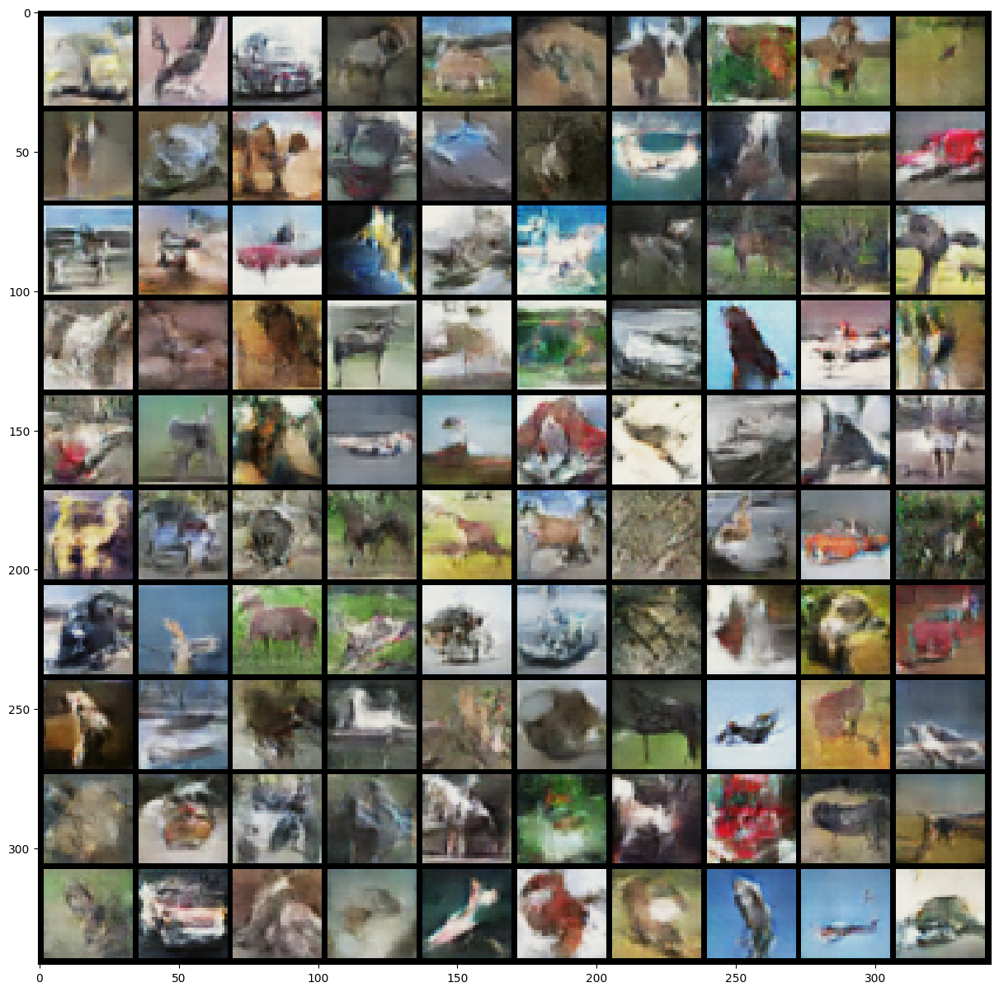

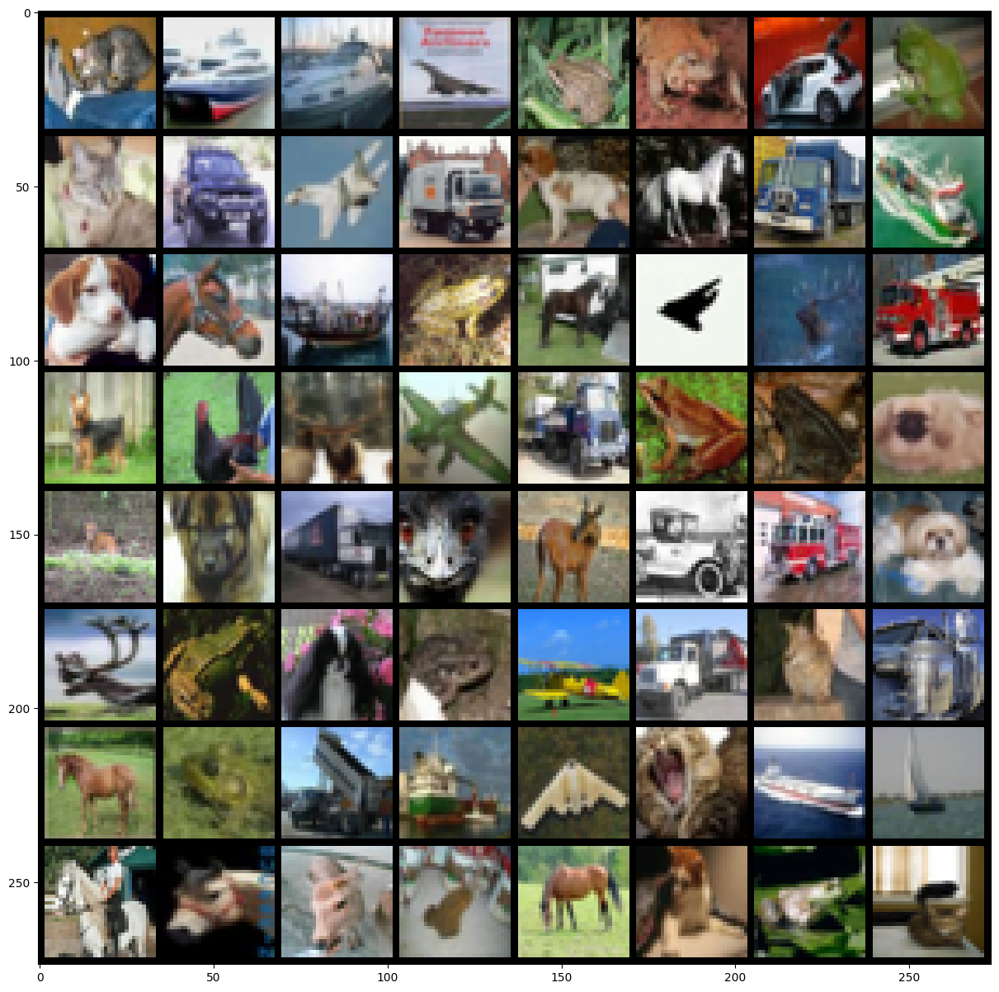

In [175]:
input_noise = torch.randn(100, latent_vector_size, 1, 1, device=device)
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(denorm(generated)[:100], nrow=10, padding=2, normalize=False, 
                        value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    save_image(generated, content_path/'CW_GAN/Teaching_final.png')
    show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

## Part 2.1d: Engineering Choices (10 Points)

Discuss the process you took to arrive at your final architecture. This should include:

* Which empirically useful methods did you utilize
* What didn't work, what worked and what mattered most
* Are there any tricks you came across in the literature etc. which you suspect would be helpful here

**Your Answer**


( The figures can be seen in this word document: 
https://docs.google.com/document/d/1Pad0r-8nWP3Qxngq-99sjHZyUfCkZCDn/edit?usp=sharing&ouid=109346686061891100595&rtpof=true&sd=true  )

To compare my experiments of the different hyperparameters, i decided to look at both the losses and the images. But i mostly used the images to make conclusions and 
decide which hyperparameters are better as in an image is easy to see if the image is green pixelated, grey or if the image is actually good and you can distinguish
objects like cars or horses, animals or ther animals' legs and etc. Also, we have two different losses as explained before and therefore it is really difficult to 
make decisions just based on those.

My architecture is mainly based on the paper you recommended us in the cells above, but as 
its result are for dimensions of size 64, i just added one less layer in it to make its output into size of 32.
My generator has 4 different convolutions (transpose) layers and my discriminator
has 6 layers of convolutions wth different kernel sizes, strides and paddings, so each layer 
will detect different information in the images and can discriminate based on different properties,parts of the image.
As the paper suggests after each layer in the generator i use a batch normalization,
Relu activation function and the final result is produced using the Tanh activation function.
In the discriminator after each layer i added a batch normalization, leaky relu and dropout
and the final layer produces its results using the sigmoid function.
Also, my latent size is initially 100 and batch size is 128.
Furthermore, i added one-sided label smoothing, which is a regularization 
technique to enhance the performance and generalization. In this i substitute
the values of 0 and 1 of the targets to 0.1 and 0.9 respectively to smooth the values.
Even though the paper gives me these suggestions i decided to change many hyperparameter
throughout my process to find the best ones and i actually used the suggestions of the
paper as baseline and as my starting point.

I run my experiments for 20 epochs just to get an idea for which hypeparameters are better and then i run the best models for 100 epochs to decide which is the best
and which i should use.

In my first experiment i used batch size of 128 and learning rate of 0.0001(Figure 1) and produced
some good,moderate results. After that i used a smaller batch size of 64 which produced similar results (Figure 2), so i kept the previous batch size as we know that it
is better to keep the batch size bigger.
After that i changed the leaky relu of the discriminator to relu and it performed worse
and then i made the learning rate higher(0.001) which again made it more difficult for the network to learn
and performed poorly (Figure 3). I also used smaller learning rate(0.00001) and was also worse
After reading the paper again i noticed that they also suggest to use dropout in the discriminator
so i decided to try out different droupouts, with different probability.
Firstly, i used the dropout of 0.5 (figure 4) which performed slightly better than before.
Furthermore, i used a dropout of 0.2 (figure 5) which actually made the model a lot better so i 
kept that one.After this, i deleted the tanh (figure 6) in the discriminator and performed worse than before.

The next step i did was to try a different beta of 0.9 (figure 7) which performed worse.
Throughout all this process my results had a gray color so i decided to try different 
standard deviation for the normalization of the images. The images had this gray colour when the standard deviation was (0.247, 0.243, 0.261).
First i used the standard deviation of 0.45 (figure 8) for each channel and then 0.65 (figure 9), the 0.45 performed the best and solved the problem
i had with the grey extra color-filer in front of the pictures. This step was a milestone for my experiments as the colours started to be better (no more grey)
and i could actually start to understand some animals, objects and etc., so i believe this is the most "important" change i made throughout my process.

After all these, i decided to change the learning rate to 0.00001 which performed really poorly, it
produced green pixelated images and then i increased the batch size to 256 (figure 10) but was not as good as 128.
Finally i run my model with a beta of 0.2 (figure 11) which had very similar results to the beta of 0.5. I added
a different learning rate in my discriminator in comparisont to the generator (increased it by 10 times than the generator) , which
i expected to perform a lot better but it was actually worse, so i kept the same learning rate as it was before for both, the generator and the discriminator.

Finally, i decided to icrease the latent size to 170 (figure 12) as it can improve the variability of the
generated samples, which it actually did! But, i checked again the number of parameters
used and they were over 25 million, so i reduced the size to 158 , to have slightly less than 25 million parameters as the instruction says.
So, to summarize my model architecture is the one i explained in the beggining with the addition of dropout of p equal to 0.2 in the discriminator.
The latent size is 158,learning rate is 0.0001 and beta is 0.5, and the standard deviation for the normalization process in the first cell is 0.45.
I trained the model with 100 epochs to produce my final model.

The final model's generated images are displayed in Figure 13 and i believe they are very good as there is no model collapse, we can see different objects 
like horses, birds and cars and more. Also, in many images we can easily understand which animal it shows and can distinguish unique characteristics of the object like
legs of the animals, its head or the wheels in the cars. So, overall i believe that the generated images are very good. Also, i believe that the fact that i was the one that distinguishing which image is better may be a negative in the whole procedure as for some models the actual difference in the image in the human eyes were not easily seen
and maybe we should use another metric to actually measure how close our image was to the target image. But overall, i believe it can generate good images and that through the
whole procedure i explained above we can see the advancements through the hyperparameter tuning.  


## Part 2.2: Understanding GAN Training (5 points)


### Loss Curves
**Your task:**


Plot the losses curves for the discriminator $D$ and the generator $G$ as the training progresses and explain whether the produced curves are theoretically sensible and why this is (or not) the case (x-axis: epochs, y-axis: loss).

Make sure that the version of the notebook you deliver includes these results.

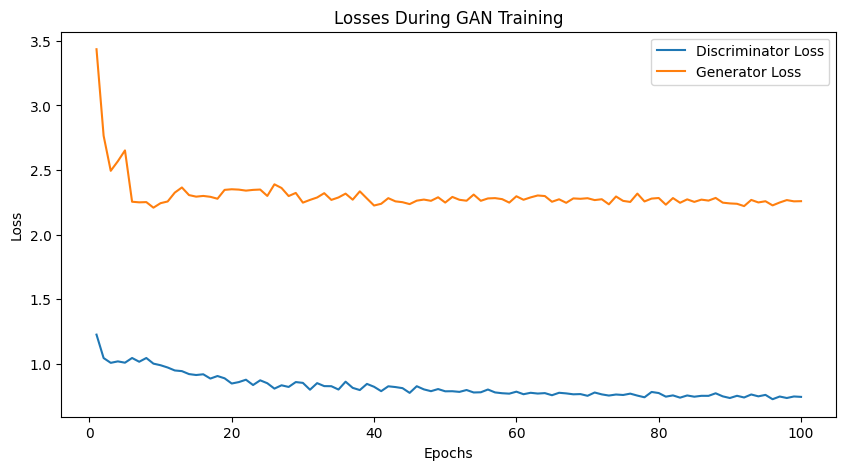

In [177]:
# ANSWER FOR PART 2.2 IN THIS CELL*

# plotting the losses of the discriminator and generator,i actually plot the lists which we get throughout the training
import matplotlib.pyplot as plt

epochs = range(1, len(train_losses_D) + 1)
plt.figure(figsize=(10,5))
plt.plot(epochs, train_losses_D, label='Discriminator Loss')
plt.plot(epochs, train_losses_G, label='Generator Loss')
plt.title('Losses During GAN Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()



### Discussion

Do your loss curves look sensible? What would you expect to see and why?

**YOUR ANSWER**

As we know we have two different losses, the loss of the generator that creates
the fake images and the loss of discriminator which tries to classify the images as 
fake and real. The generator tries to trick the discriminator and throughout the 
training and epochs it becomes very good in creating images.
Throughout the epochs the discriminator loss should reduce as it becomes
better in classifying an image as fake or real, and the generator loss
should alos decrease as it becomes better in creating images that are more realistic.
The expected trend of the losses can be seen in our figure which indicates that
the whole process, training is made correctly and as explected.
After 30 epochs the discriminator has loss around 0.5 and generator at around 2.25.
Consequently, the discriminator becomes better, but as the generator loss is not
decreasing (after 30 epochs) means that it is also getting better at tricking the
discriminator and makes better fake images.
The loss curves seem sensible, as both losses start from a high point and decrease
and flunctuate a little. Finally, the discriminator loss is lower than the generator's as can be seen in the figure.

 

## Part 2.3: Understanding Mode Collapse (5 points) 
**Your task:**
 
Describe the what causes the phenomenon of Mode Collapse and how it may manifest in the samples from a GAN. 

Based on the images created by your generator using the `fixed_noise` vector during training, did you notice any mode collapse? what this behaviour may be attributed to, and what did you try to eliminate / reduce it?

### Discussion


**YOUR ANSWER**

The phenomenon of Model collapse is very usual in the GAN and we have to take
some measures to mitigate it. Model collapse is when the generator of the GAN
creates samples,images, that are limited to some modes and ignores other possibole
modes from the data distribution leading to a lack of diversity. 
For example in the Figure 14 (in the document https://docs.google.com/document/d/1Pad0r-8nWP3Qxngq-99sjHZyUfCkZCDn/edit?usp=sharing&ouid=109346686061891100595&rtpof=true&sd=true ) which is the result of the 10th epoch of my training, there is model collapse as we can see that the same
colors and shapes are appearing in a lot of images.

There are a lot of reasons for which this situation may be happening. As the GAN is a two player game 
between the discriminator and the generator it may mean that the discriminator may be very good in 
classifying the images to fake and real and therefore it is difficult for the generator to create images
to trick the discriminator. Because of this situation, the generator may
focus in creating some specific images, shapes, colours and becoming good in making only those
and consequently leading to the model collapse problem as it does not
focus to the greater distribution of the data but only to a subset of it.
In general, the dataset may lead to this problem, when it is not generic,
eg. there are only images of dogs that seem similar, but i do not think
we have this problem in our dataset as we have many different animals and some cars but it is still a small dataset.
To prevent this problem we introduced some mechanisms, strategies as suggested by the paper.
We added the batchnormalization after each layer in the generator, we added the tanh activation
function in the that produces results from -1 to 1. Finally, different architectures
can be used like more number of layers, different kernel sizes, strides to make the 
convolutions layer to pick different spatial data, from different angles of the images
and other mechanisms like the relu activation function between the layers and the tanh to produce the result.
In general it is a very common issue, that can be solved through an exhausting hyperparameter tuning like i did and we can see the result in my generated images as
they are very diversed and have different animals, colours and objects.



# TA Test Cell
TAs will run this cell to ensure that your results are reproducible, and that your models have been defined suitably. 

<font color="orange"> <b> Please provide the input and output transformations required to make your VAE and GANs work. If your GAN generator requires more than just noise as input, also specify this below (there are two marked cells for you to inspect) </b></font>


In [74]:
# If you want to run these tests yourself, change directory:
# %cd '.../dl_cw2/'
ta_data_path = "../data" # You can change this to = data_path when testing

In [75]:
!pip install -q torch torchvision

In [76]:
# Do not remove anything here
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt 

show = lambda img: plt.imshow(np.transpose(img.cpu().numpy(), (1,2,0)))

device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")

# Do not change this cell!
torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

In [77]:
############# CHANGE THESE (COPY AND PASTE FROM YOUR OWN CODE) #############
vae_transform = transforms.Compose([
    transforms.ToTensor(),
])

def vae_denorm(x):
    return x

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.45, 0.45, 0.45])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def gan_denorm(x, channels=None, w=None ,h=None, resize = False):
    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x


gan_latent_size = 158

# If your generator requires something other than noise as input, please specify
# two cells down from here

In [78]:
# Load VAE Dataset
test_dat = datasets.MNIST(ta_data_path, train=False, transform=vae_transform, 
                          download=True)
vae_loader_test = DataLoader(test_dat, batch_size=32, shuffle=False)

In [79]:
############# MODIFY IF NEEDED #############
vae_input, _ = next(iter(vae_loader_test))

# If your generator is conditional, then please modify this input suitably
input_noise = torch.randn(100, gan_latent_size, 1, 1, device=device)
gan_input = [input_noise] # In case you want to provide a tuple, we wrap ours

Used CNN


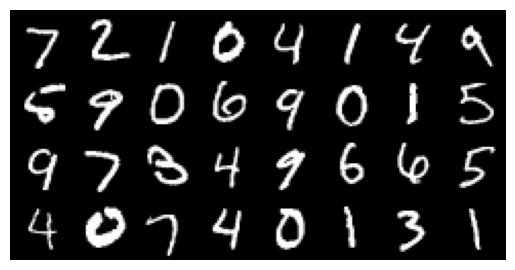

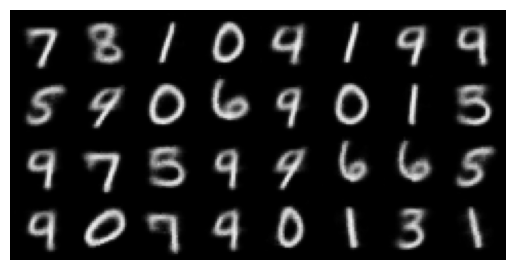

In [80]:
# VAE Tests
# TAs will change these paths as you will have provided the model files manually
"""To TAs, you should have been creating a folder with the student uid
   And the .ipynb + models in the root. Then that path is './VAE_model.pth' etc.
"""
vae = model_G = torch.jit.load('./CW_VAE/VAE_model.pth')
vae.eval()

# Check if VAE is convolutional
def recurse_cnn_check(parent, flag):
    if flag:
        return flag
    children = list(parent.children())
    if len(children) > 0:
        for child in children:
            flag = flag or recurse_cnn_check(child, flag)
    else:
        params = parent._parameters
        if 'weight' in params.keys():
            flag = params['weight'].ndim == 4
    return flag

has_cnn = recurse_cnn_check(vae, False)
print("Used CNN" if has_cnn else "Didn't Use CNN")

vae_in = make_grid(vae_denorm(vae_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_in)

vae_test = vae(vae_input.to(device))[0].detach()
vae_reco = make_grid(vae_denorm(vae_test), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_reco)

Number of Parameters is 24968192 which is ok


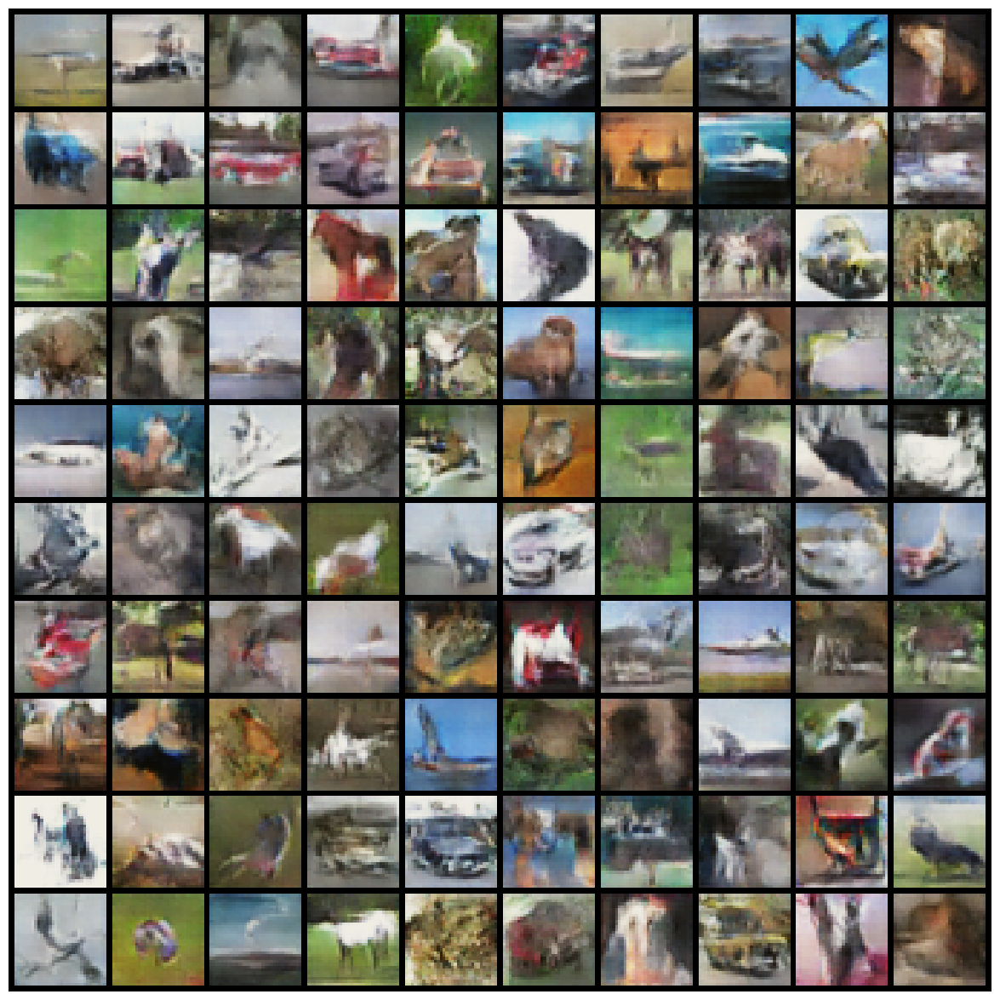

In [81]:
# GAN Tests
model_G = torch.jit.load('./CW_GAN/GAN_G_model.pth')
model_D = torch.jit.load('./CW_GAN/GAN_D_model.pth')
[model.eval() for model in (model_G, model_D)]  

# Check that GAN doesn't have too many parameters
num_param = sum(p.numel() for p in [*model_G.parameters(),*model_D.parameters()])

print(f"Number of Parameters is {num_param} which is", "ok" if num_param<25E+6 else "not ok")

# visualize the generated images
generated = model_G(*gan_input).cpu()
generated = make_grid(gan_denorm(generated)[:100].detach(), nrow=10, padding=2, normalize=False, 
                    value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
plt.axis('off')
show(generated)